# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

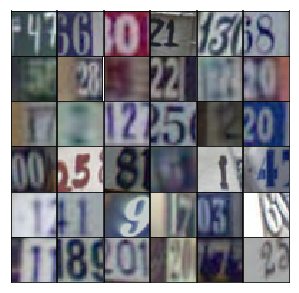

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    print(real_dim)
    print(z_dim)
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1_1 = tf.layers.dense(z, 4*4*512)
        x1_2 = tf.reshape(x1_1, [-1, 4, 4, 512])
        x1_3 = tf.layers.batch_normalization(x1_2, training=training)
        x1_4 = tf.maximum(alpha * x1_3, x1_3)
        
        x2_1 = tf.layers.conv2d_transpose(x1_4, 256, 5, strides=2, padding='same')
        x2_2 = tf.layers.batch_normalization(x2_1, training=training)
        x2_3 = tf.maximum(alpha * x2_2, x2_2)
        
        x3_1 = tf.layers.conv2d_transpose(x2_3, 128, 5, strides=2, padding='same')
        x3_2 = tf.layers.batch_normalization(x3_1, training=training)
        x3_3 = tf.maximum(alpha * x3_2, x3_2)
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3_3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        
        flatten = tf.contrib.layers.flatten(relu3) 
        logits = tf.layers.dense(flatten, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

(32, 32, 3)
100


Epoch 1/25... Discriminator Loss: 1.0027... Generator Loss: 0.9055
Epoch 1/25... Discriminator Loss: 0.5217... Generator Loss: 1.4502
Epoch 1/25... Discriminator Loss: 0.2427... Generator Loss: 2.0533
Epoch 1/25... Discriminator Loss: 0.1314... Generator Loss: 3.1754
Epoch 1/25... Discriminator Loss: 0.1252... Generator Loss: 2.9907
Epoch 1/25... Discriminator Loss: 0.4512... Generator Loss: 2.1534
Epoch 1/25... Discriminator Loss: 0.9384... Generator Loss: 2.0211
Epoch 1/25... Discriminator Loss: 1.1819... Generator Loss: 0.7920
Epoch 1/25... Discriminator Loss: 1.0487... Generator Loss: 1.3517
Epoch 1/25... Discriminator Loss: 0.4337... Generator Loss: 1.7608


/usr/local/lib64/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


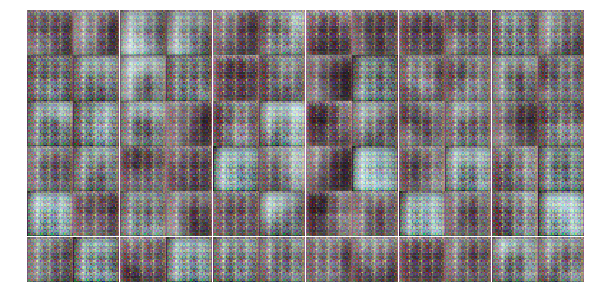

Epoch 1/25... Discriminator Loss: 0.4784... Generator Loss: 1.7418
Epoch 1/25... Discriminator Loss: 0.4830... Generator Loss: 1.5146
Epoch 1/25... Discriminator Loss: 0.6940... Generator Loss: 1.3284
Epoch 1/25... Discriminator Loss: 0.4291... Generator Loss: 2.1937
Epoch 1/25... Discriminator Loss: 0.7723... Generator Loss: 1.6279
Epoch 1/25... Discriminator Loss: 0.3375... Generator Loss: 1.8226
Epoch 1/25... Discriminator Loss: 0.4522... Generator Loss: 3.6073
Epoch 1/25... Discriminator Loss: 0.4999... Generator Loss: 2.4888
Epoch 1/25... Discriminator Loss: 0.5285... Generator Loss: 1.7466
Epoch 1/25... Discriminator Loss: 0.5994... Generator Loss: 2.4462


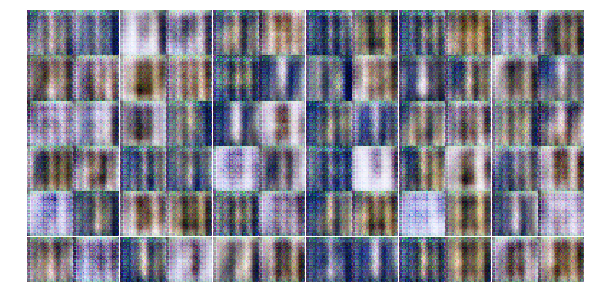

Epoch 1/25... Discriminator Loss: 1.1614... Generator Loss: 0.6513
Epoch 1/25... Discriminator Loss: 0.3645... Generator Loss: 2.5493
Epoch 1/25... Discriminator Loss: 1.6076... Generator Loss: 0.3012
Epoch 1/25... Discriminator Loss: 0.4678... Generator Loss: 1.6274
Epoch 1/25... Discriminator Loss: 0.9597... Generator Loss: 1.7275
Epoch 1/25... Discriminator Loss: 0.9309... Generator Loss: 1.1076
Epoch 1/25... Discriminator Loss: 1.0719... Generator Loss: 0.7005
Epoch 1/25... Discriminator Loss: 0.8464... Generator Loss: 1.3063
Epoch 1/25... Discriminator Loss: 0.5491... Generator Loss: 1.4669
Epoch 1/25... Discriminator Loss: 0.5099... Generator Loss: 2.2363


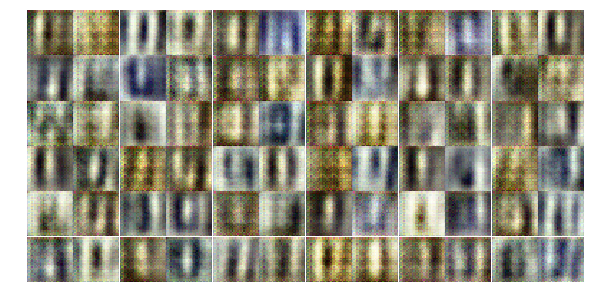

Epoch 1/25... Discriminator Loss: 0.6071... Generator Loss: 1.8020
Epoch 1/25... Discriminator Loss: 0.6127... Generator Loss: 1.3801
Epoch 1/25... Discriminator Loss: 1.0863... Generator Loss: 0.8542
Epoch 1/25... Discriminator Loss: 0.4335... Generator Loss: 1.9627
Epoch 1/25... Discriminator Loss: 0.4086... Generator Loss: 1.9658
Epoch 1/25... Discriminator Loss: 0.5690... Generator Loss: 1.4432
Epoch 1/25... Discriminator Loss: 0.5349... Generator Loss: 1.4073
Epoch 1/25... Discriminator Loss: 0.3716... Generator Loss: 2.3314
Epoch 1/25... Discriminator Loss: 0.7974... Generator Loss: 1.3764
Epoch 1/25... Discriminator Loss: 0.5526... Generator Loss: 1.3549


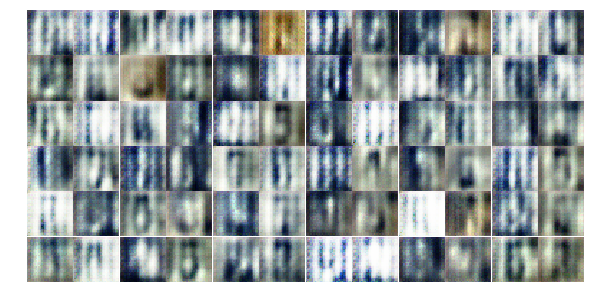

Epoch 1/25... Discriminator Loss: 0.6008... Generator Loss: 1.2998
Epoch 1/25... Discriminator Loss: 0.5847... Generator Loss: 1.5579
Epoch 1/25... Discriminator Loss: 0.6077... Generator Loss: 1.7012
Epoch 1/25... Discriminator Loss: 0.8318... Generator Loss: 0.9839
Epoch 1/25... Discriminator Loss: 0.4740... Generator Loss: 2.0284
Epoch 1/25... Discriminator Loss: 0.9776... Generator Loss: 1.9808
Epoch 1/25... Discriminator Loss: 1.1899... Generator Loss: 0.7982
Epoch 1/25... Discriminator Loss: 1.1101... Generator Loss: 1.9382
Epoch 1/25... Discriminator Loss: 0.6985... Generator Loss: 1.3323
Epoch 1/25... Discriminator Loss: 0.8712... Generator Loss: 1.2642


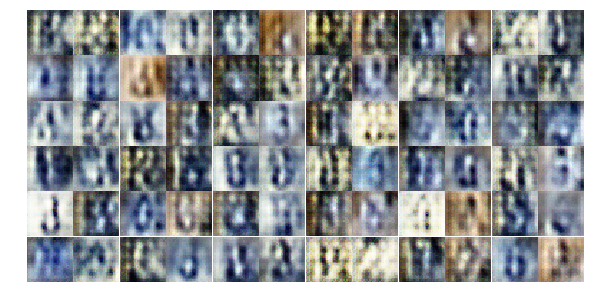

Epoch 1/25... Discriminator Loss: 0.6781... Generator Loss: 1.3669
Epoch 1/25... Discriminator Loss: 2.2771... Generator Loss: 0.2115
Epoch 1/25... Discriminator Loss: 0.9846... Generator Loss: 1.5661
Epoch 1/25... Discriminator Loss: 0.8710... Generator Loss: 0.9655
Epoch 1/25... Discriminator Loss: 0.4881... Generator Loss: 1.8544
Epoch 1/25... Discriminator Loss: 0.6488... Generator Loss: 1.6579
Epoch 1/25... Discriminator Loss: 0.6411... Generator Loss: 1.4414
Epoch 2/25... Discriminator Loss: 0.8340... Generator Loss: 1.4154
Epoch 2/25... Discriminator Loss: 0.6933... Generator Loss: 1.6412
Epoch 2/25... Discriminator Loss: 0.9485... Generator Loss: 0.8565


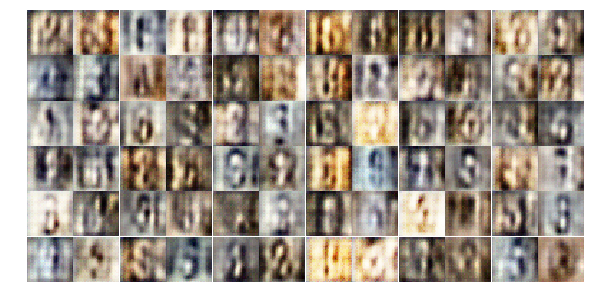

Epoch 2/25... Discriminator Loss: 0.7670... Generator Loss: 1.8557
Epoch 2/25... Discriminator Loss: 0.9127... Generator Loss: 1.2489
Epoch 2/25... Discriminator Loss: 0.7294... Generator Loss: 1.2066
Epoch 2/25... Discriminator Loss: 0.6291... Generator Loss: 1.3093
Epoch 2/25... Discriminator Loss: 0.8834... Generator Loss: 0.9380
Epoch 2/25... Discriminator Loss: 0.9159... Generator Loss: 1.2216
Epoch 2/25... Discriminator Loss: 1.0403... Generator Loss: 0.9544
Epoch 2/25... Discriminator Loss: 1.1766... Generator Loss: 0.9322
Epoch 2/25... Discriminator Loss: 0.9054... Generator Loss: 1.5172
Epoch 2/25... Discriminator Loss: 0.9116... Generator Loss: 1.4143


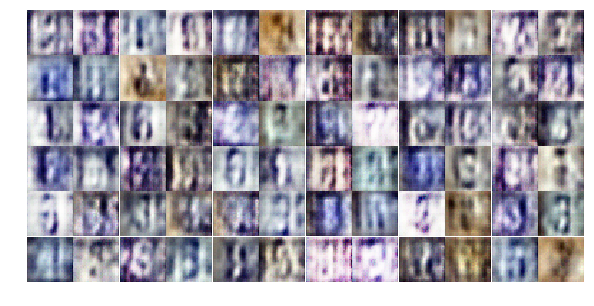

Epoch 2/25... Discriminator Loss: 1.1865... Generator Loss: 1.3546
Epoch 2/25... Discriminator Loss: 1.1029... Generator Loss: 1.0478
Epoch 2/25... Discriminator Loss: 0.9832... Generator Loss: 1.0346
Epoch 2/25... Discriminator Loss: 0.7951... Generator Loss: 1.0587
Epoch 2/25... Discriminator Loss: 0.8897... Generator Loss: 1.2923
Epoch 2/25... Discriminator Loss: 1.3994... Generator Loss: 0.7352
Epoch 2/25... Discriminator Loss: 1.1089... Generator Loss: 0.8392
Epoch 2/25... Discriminator Loss: 1.2639... Generator Loss: 0.6846
Epoch 2/25... Discriminator Loss: 1.0734... Generator Loss: 0.9292
Epoch 2/25... Discriminator Loss: 1.0946... Generator Loss: 0.7064


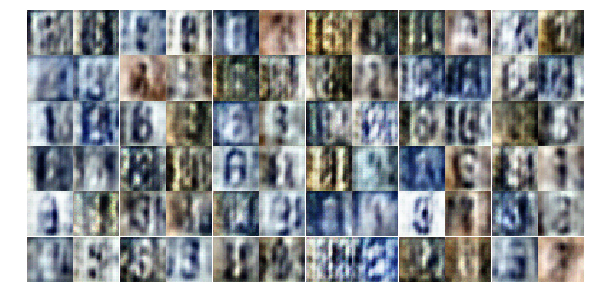

Epoch 2/25... Discriminator Loss: 1.5233... Generator Loss: 0.7231
Epoch 2/25... Discriminator Loss: 0.9646... Generator Loss: 0.9906
Epoch 2/25... Discriminator Loss: 0.8308... Generator Loss: 1.9187
Epoch 2/25... Discriminator Loss: 0.9456... Generator Loss: 1.2503
Epoch 2/25... Discriminator Loss: 1.1539... Generator Loss: 1.0415
Epoch 2/25... Discriminator Loss: 1.0860... Generator Loss: 0.7795
Epoch 2/25... Discriminator Loss: 1.2527... Generator Loss: 0.5553
Epoch 2/25... Discriminator Loss: 0.9078... Generator Loss: 0.8866
Epoch 2/25... Discriminator Loss: 1.1186... Generator Loss: 1.1799
Epoch 2/25... Discriminator Loss: 0.9001... Generator Loss: 0.9880


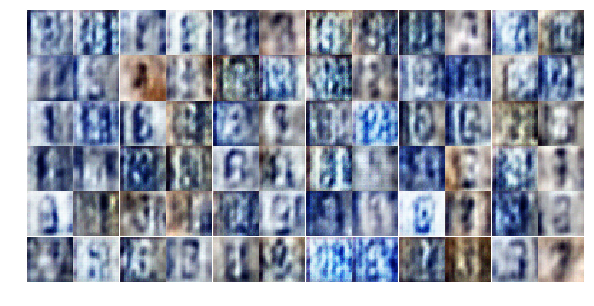

Epoch 2/25... Discriminator Loss: 1.3773... Generator Loss: 0.5932
Epoch 2/25... Discriminator Loss: 1.2132... Generator Loss: 0.8641
Epoch 2/25... Discriminator Loss: 1.3048... Generator Loss: 0.6118
Epoch 2/25... Discriminator Loss: 1.3873... Generator Loss: 0.5539
Epoch 2/25... Discriminator Loss: 1.1485... Generator Loss: 0.9975
Epoch 2/25... Discriminator Loss: 0.9739... Generator Loss: 1.3227
Epoch 2/25... Discriminator Loss: 1.2087... Generator Loss: 1.0375
Epoch 2/25... Discriminator Loss: 1.3258... Generator Loss: 1.0771
Epoch 2/25... Discriminator Loss: 1.0466... Generator Loss: 0.8817
Epoch 2/25... Discriminator Loss: 1.3236... Generator Loss: 0.9202


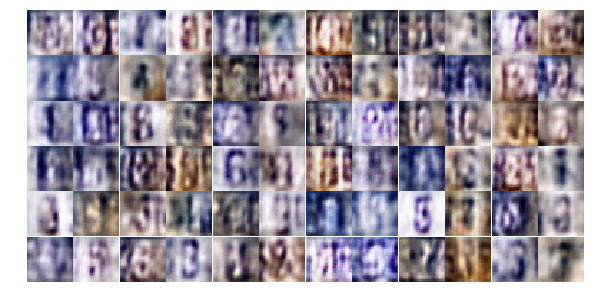

Epoch 2/25... Discriminator Loss: 0.9865... Generator Loss: 1.1678
Epoch 2/25... Discriminator Loss: 0.9412... Generator Loss: 1.2265
Epoch 2/25... Discriminator Loss: 0.9750... Generator Loss: 0.9075
Epoch 2/25... Discriminator Loss: 1.0924... Generator Loss: 0.9997
Epoch 2/25... Discriminator Loss: 1.0589... Generator Loss: 0.9580
Epoch 2/25... Discriminator Loss: 1.0979... Generator Loss: 0.7340
Epoch 2/25... Discriminator Loss: 0.9458... Generator Loss: 1.2000
Epoch 2/25... Discriminator Loss: 1.0164... Generator Loss: 1.1271
Epoch 2/25... Discriminator Loss: 0.6233... Generator Loss: 1.7870
Epoch 2/25... Discriminator Loss: 0.9124... Generator Loss: 1.2007


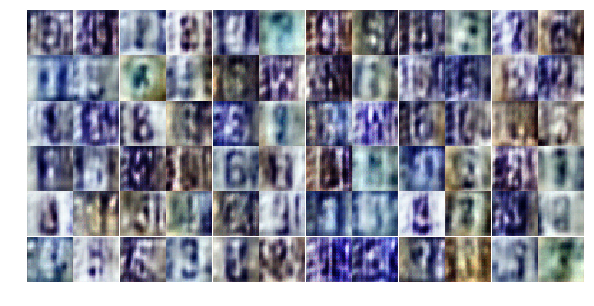

Epoch 2/25... Discriminator Loss: 0.9226... Generator Loss: 1.0967
Epoch 2/25... Discriminator Loss: 0.7491... Generator Loss: 1.2524
Epoch 2/25... Discriminator Loss: 1.1882... Generator Loss: 0.6201
Epoch 2/25... Discriminator Loss: 0.9363... Generator Loss: 1.1449
Epoch 3/25... Discriminator Loss: 0.8825... Generator Loss: 1.7918
Epoch 3/25... Discriminator Loss: 1.0327... Generator Loss: 1.0401
Epoch 3/25... Discriminator Loss: 1.3798... Generator Loss: 0.4657
Epoch 3/25... Discriminator Loss: 0.6402... Generator Loss: 1.3814
Epoch 3/25... Discriminator Loss: 0.8745... Generator Loss: 2.0837
Epoch 3/25... Discriminator Loss: 0.9631... Generator Loss: 1.1595


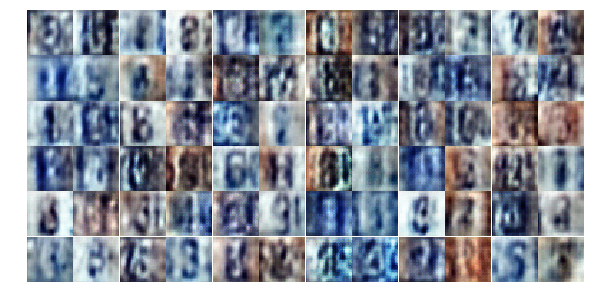

Epoch 3/25... Discriminator Loss: 0.5266... Generator Loss: 2.4899
Epoch 3/25... Discriminator Loss: 0.7839... Generator Loss: 0.9067
Epoch 3/25... Discriminator Loss: 0.6797... Generator Loss: 1.0880
Epoch 3/25... Discriminator Loss: 0.9412... Generator Loss: 0.7463
Epoch 3/25... Discriminator Loss: 1.0992... Generator Loss: 1.9134
Epoch 3/25... Discriminator Loss: 0.7511... Generator Loss: 1.0499
Epoch 3/25... Discriminator Loss: 0.9247... Generator Loss: 1.0810
Epoch 3/25... Discriminator Loss: 0.4482... Generator Loss: 1.9515
Epoch 3/25... Discriminator Loss: 1.2641... Generator Loss: 0.4614
Epoch 3/25... Discriminator Loss: 0.8803... Generator Loss: 1.0447


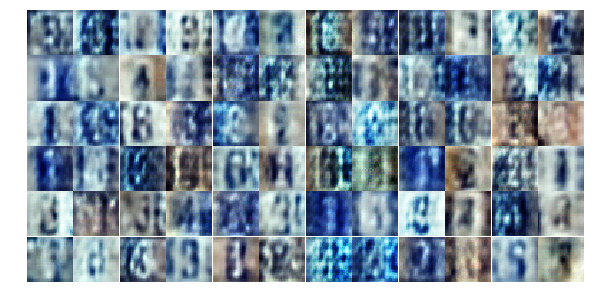

Epoch 3/25... Discriminator Loss: 0.9299... Generator Loss: 0.6838
Epoch 3/25... Discriminator Loss: 0.9624... Generator Loss: 0.6989
Epoch 3/25... Discriminator Loss: 0.4079... Generator Loss: 2.7800
Epoch 3/25... Discriminator Loss: 0.9910... Generator Loss: 0.6927
Epoch 3/25... Discriminator Loss: 1.0428... Generator Loss: 2.4202
Epoch 3/25... Discriminator Loss: 0.6871... Generator Loss: 1.8127
Epoch 3/25... Discriminator Loss: 1.7537... Generator Loss: 0.2556
Epoch 3/25... Discriminator Loss: 0.8059... Generator Loss: 0.8319
Epoch 3/25... Discriminator Loss: 1.2120... Generator Loss: 4.0979
Epoch 3/25... Discriminator Loss: 1.4041... Generator Loss: 0.4374


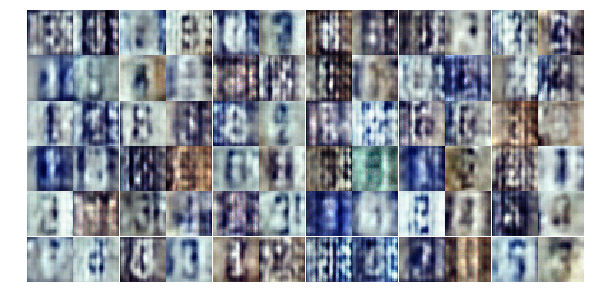

Epoch 3/25... Discriminator Loss: 0.6741... Generator Loss: 1.4985
Epoch 3/25... Discriminator Loss: 0.9305... Generator Loss: 1.4403
Epoch 3/25... Discriminator Loss: 0.8346... Generator Loss: 1.1295
Epoch 3/25... Discriminator Loss: 0.8503... Generator Loss: 2.2183
Epoch 3/25... Discriminator Loss: 0.7453... Generator Loss: 1.1865
Epoch 3/25... Discriminator Loss: 0.6030... Generator Loss: 1.3782
Epoch 3/25... Discriminator Loss: 0.6572... Generator Loss: 1.9717
Epoch 3/25... Discriminator Loss: 0.7808... Generator Loss: 2.5021
Epoch 3/25... Discriminator Loss: 0.9727... Generator Loss: 3.1244
Epoch 3/25... Discriminator Loss: 1.2974... Generator Loss: 0.5351


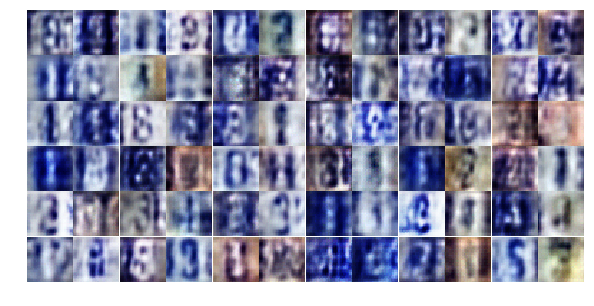

Epoch 3/25... Discriminator Loss: 0.5746... Generator Loss: 2.3418
Epoch 3/25... Discriminator Loss: 1.5374... Generator Loss: 0.3235
Epoch 3/25... Discriminator Loss: 0.4454... Generator Loss: 2.2736
Epoch 3/25... Discriminator Loss: 1.2570... Generator Loss: 0.4843
Epoch 3/25... Discriminator Loss: 0.6698... Generator Loss: 3.2413
Epoch 3/25... Discriminator Loss: 0.6201... Generator Loss: 1.1923
Epoch 3/25... Discriminator Loss: 0.8701... Generator Loss: 0.8952
Epoch 3/25... Discriminator Loss: 1.1764... Generator Loss: 0.5835
Epoch 3/25... Discriminator Loss: 0.6474... Generator Loss: 2.5604
Epoch 3/25... Discriminator Loss: 0.5478... Generator Loss: 1.4771


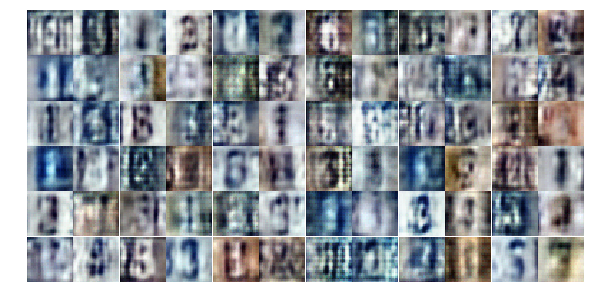

Epoch 3/25... Discriminator Loss: 0.6502... Generator Loss: 1.4184
Epoch 3/25... Discriminator Loss: 0.3244... Generator Loss: 2.0030
Epoch 3/25... Discriminator Loss: 0.7762... Generator Loss: 0.9997
Epoch 3/25... Discriminator Loss: 0.8282... Generator Loss: 1.6356
Epoch 3/25... Discriminator Loss: 0.5612... Generator Loss: 3.0563
Epoch 3/25... Discriminator Loss: 0.3312... Generator Loss: 2.4495
Epoch 3/25... Discriminator Loss: 0.7440... Generator Loss: 0.9951
Epoch 3/25... Discriminator Loss: 0.3958... Generator Loss: 1.6689
Epoch 3/25... Discriminator Loss: 0.5007... Generator Loss: 1.7688
Epoch 3/25... Discriminator Loss: 0.6569... Generator Loss: 1.1513


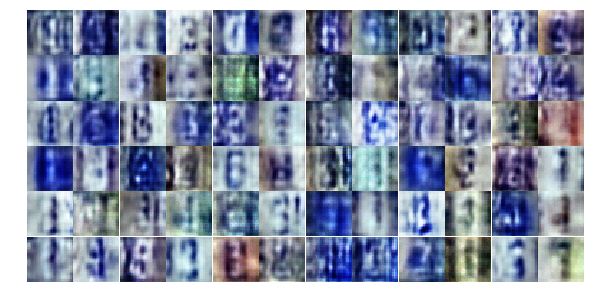

Epoch 3/25... Discriminator Loss: 0.6413... Generator Loss: 1.3650
Epoch 4/25... Discriminator Loss: 1.1592... Generator Loss: 0.5320
Epoch 4/25... Discriminator Loss: 0.5027... Generator Loss: 2.3745
Epoch 4/25... Discriminator Loss: 0.8716... Generator Loss: 0.8533
Epoch 4/25... Discriminator Loss: 0.4378... Generator Loss: 2.1003
Epoch 4/25... Discriminator Loss: 0.3092... Generator Loss: 1.9717
Epoch 4/25... Discriminator Loss: 1.2431... Generator Loss: 0.4828
Epoch 4/25... Discriminator Loss: 0.4622... Generator Loss: 2.5475
Epoch 4/25... Discriminator Loss: 0.8080... Generator Loss: 0.8068
Epoch 4/25... Discriminator Loss: 0.5649... Generator Loss: 1.4885


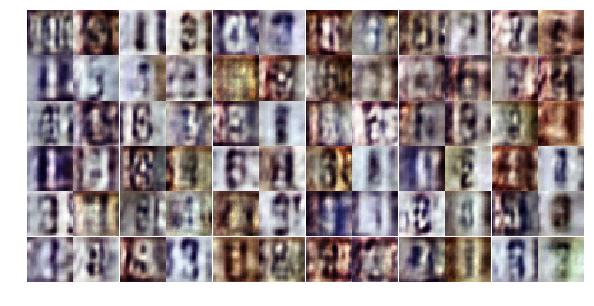

Epoch 4/25... Discriminator Loss: 0.4751... Generator Loss: 1.6199
Epoch 4/25... Discriminator Loss: 0.8826... Generator Loss: 0.7556
Epoch 4/25... Discriminator Loss: 1.4032... Generator Loss: 0.6325
Epoch 4/25... Discriminator Loss: 1.3870... Generator Loss: 0.4402
Epoch 4/25... Discriminator Loss: 0.4066... Generator Loss: 1.6708
Epoch 4/25... Discriminator Loss: 0.7269... Generator Loss: 0.9769
Epoch 4/25... Discriminator Loss: 0.8874... Generator Loss: 1.0409
Epoch 4/25... Discriminator Loss: 0.7788... Generator Loss: 2.8063
Epoch 4/25... Discriminator Loss: 0.4275... Generator Loss: 1.6193
Epoch 4/25... Discriminator Loss: 0.7448... Generator Loss: 1.0616


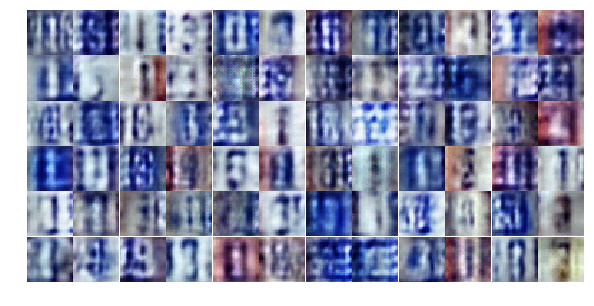

Epoch 4/25... Discriminator Loss: 0.3838... Generator Loss: 2.4338
Epoch 4/25... Discriminator Loss: 0.3209... Generator Loss: 2.2471
Epoch 4/25... Discriminator Loss: 0.8172... Generator Loss: 0.8853
Epoch 4/25... Discriminator Loss: 0.7327... Generator Loss: 0.9474
Epoch 4/25... Discriminator Loss: 0.7314... Generator Loss: 1.0422
Epoch 4/25... Discriminator Loss: 0.4911... Generator Loss: 1.5577
Epoch 4/25... Discriminator Loss: 0.7116... Generator Loss: 1.0896
Epoch 4/25... Discriminator Loss: 0.6629... Generator Loss: 1.0362
Epoch 4/25... Discriminator Loss: 0.5957... Generator Loss: 1.9754
Epoch 4/25... Discriminator Loss: 0.4879... Generator Loss: 1.8611


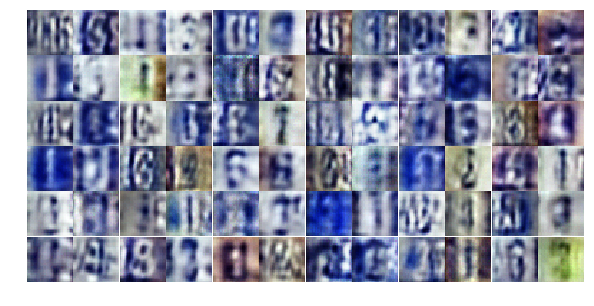

Epoch 4/25... Discriminator Loss: 0.5428... Generator Loss: 1.2678
Epoch 4/25... Discriminator Loss: 0.5864... Generator Loss: 1.3165
Epoch 4/25... Discriminator Loss: 0.7594... Generator Loss: 0.9294
Epoch 4/25... Discriminator Loss: 0.4452... Generator Loss: 2.4659
Epoch 4/25... Discriminator Loss: 0.3244... Generator Loss: 3.0552
Epoch 4/25... Discriminator Loss: 0.5462... Generator Loss: 1.5402
Epoch 4/25... Discriminator Loss: 0.5332... Generator Loss: 1.3805
Epoch 4/25... Discriminator Loss: 0.5214... Generator Loss: 1.1941
Epoch 4/25... Discriminator Loss: 0.5405... Generator Loss: 1.2913
Epoch 4/25... Discriminator Loss: 0.7484... Generator Loss: 0.9116


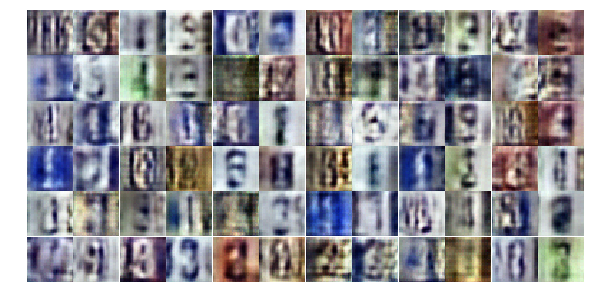

Epoch 4/25... Discriminator Loss: 0.6206... Generator Loss: 1.1340
Epoch 4/25... Discriminator Loss: 0.8791... Generator Loss: 0.8267
Epoch 4/25... Discriminator Loss: 0.6375... Generator Loss: 1.3848
Epoch 4/25... Discriminator Loss: 0.3827... Generator Loss: 2.1028
Epoch 4/25... Discriminator Loss: 0.4301... Generator Loss: 2.2058
Epoch 4/25... Discriminator Loss: 0.7768... Generator Loss: 1.2772
Epoch 4/25... Discriminator Loss: 1.3479... Generator Loss: 3.1998
Epoch 4/25... Discriminator Loss: 0.7426... Generator Loss: 1.1218
Epoch 4/25... Discriminator Loss: 0.4276... Generator Loss: 1.6690
Epoch 4/25... Discriminator Loss: 0.4285... Generator Loss: 2.4141


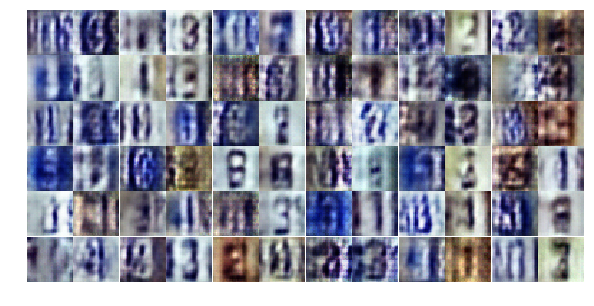

Epoch 4/25... Discriminator Loss: 0.5248... Generator Loss: 1.2428
Epoch 4/25... Discriminator Loss: 0.4788... Generator Loss: 1.9506
Epoch 4/25... Discriminator Loss: 0.3697... Generator Loss: 2.1261
Epoch 4/25... Discriminator Loss: 0.4390... Generator Loss: 1.9795
Epoch 4/25... Discriminator Loss: 0.5805... Generator Loss: 1.2787
Epoch 4/25... Discriminator Loss: 0.7171... Generator Loss: 2.1126
Epoch 4/25... Discriminator Loss: 0.5024... Generator Loss: 1.2521
Epoch 4/25... Discriminator Loss: 0.5734... Generator Loss: 1.5296
Epoch 4/25... Discriminator Loss: 0.5193... Generator Loss: 1.4264
Epoch 5/25... Discriminator Loss: 0.5851... Generator Loss: 1.1624


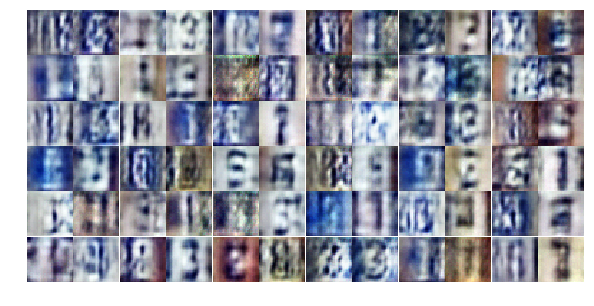

Epoch 5/25... Discriminator Loss: 0.3142... Generator Loss: 2.4475
Epoch 5/25... Discriminator Loss: 1.1534... Generator Loss: 0.5472
Epoch 5/25... Discriminator Loss: 0.5122... Generator Loss: 1.5067
Epoch 5/25... Discriminator Loss: 1.3160... Generator Loss: 0.4411
Epoch 5/25... Discriminator Loss: 0.5382... Generator Loss: 2.8143
Epoch 5/25... Discriminator Loss: 0.6709... Generator Loss: 1.1639
Epoch 5/25... Discriminator Loss: 0.4659... Generator Loss: 1.3896
Epoch 5/25... Discriminator Loss: 0.4988... Generator Loss: 1.8314
Epoch 5/25... Discriminator Loss: 0.8181... Generator Loss: 0.7910
Epoch 5/25... Discriminator Loss: 1.3203... Generator Loss: 0.6687


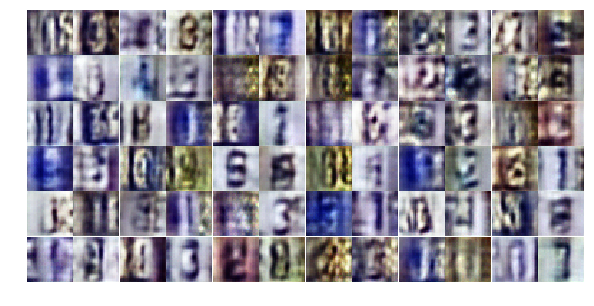

Epoch 5/25... Discriminator Loss: 0.6255... Generator Loss: 2.0939
Epoch 5/25... Discriminator Loss: 1.8412... Generator Loss: 3.6127
Epoch 5/25... Discriminator Loss: 0.6181... Generator Loss: 1.6068
Epoch 5/25... Discriminator Loss: 1.2190... Generator Loss: 0.5521
Epoch 5/25... Discriminator Loss: 0.9646... Generator Loss: 0.7395
Epoch 5/25... Discriminator Loss: 0.8506... Generator Loss: 1.0023
Epoch 5/25... Discriminator Loss: 0.5135... Generator Loss: 2.3601
Epoch 5/25... Discriminator Loss: 0.5063... Generator Loss: 1.3903
Epoch 5/25... Discriminator Loss: 0.4900... Generator Loss: 1.8506
Epoch 5/25... Discriminator Loss: 0.4534... Generator Loss: 1.7641


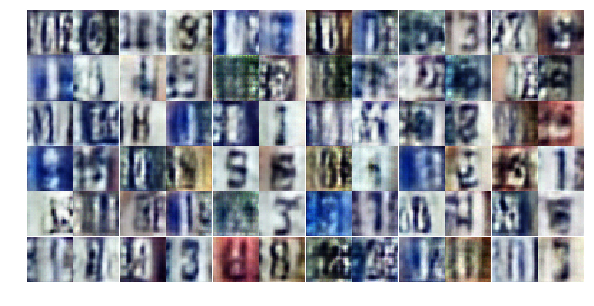

Epoch 5/25... Discriminator Loss: 0.4301... Generator Loss: 2.1883
Epoch 5/25... Discriminator Loss: 0.8204... Generator Loss: 1.0685
Epoch 5/25... Discriminator Loss: 1.1061... Generator Loss: 0.5303
Epoch 5/25... Discriminator Loss: 0.6008... Generator Loss: 1.3218
Epoch 5/25... Discriminator Loss: 0.9222... Generator Loss: 0.6470
Epoch 5/25... Discriminator Loss: 0.6164... Generator Loss: 1.1349
Epoch 5/25... Discriminator Loss: 0.6713... Generator Loss: 1.0287
Epoch 5/25... Discriminator Loss: 1.4021... Generator Loss: 0.3985
Epoch 5/25... Discriminator Loss: 0.7612... Generator Loss: 0.8851
Epoch 5/25... Discriminator Loss: 0.4574... Generator Loss: 1.8234


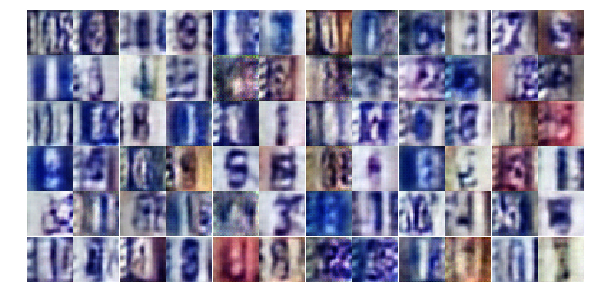

Epoch 5/25... Discriminator Loss: 0.6252... Generator Loss: 1.7723
Epoch 5/25... Discriminator Loss: 0.6048... Generator Loss: 1.1799
Epoch 5/25... Discriminator Loss: 0.5801... Generator Loss: 1.3470
Epoch 5/25... Discriminator Loss: 0.4870... Generator Loss: 1.2456
Epoch 5/25... Discriminator Loss: 1.3107... Generator Loss: 0.5055
Epoch 5/25... Discriminator Loss: 0.5426... Generator Loss: 1.9367
Epoch 5/25... Discriminator Loss: 1.0618... Generator Loss: 0.6180
Epoch 5/25... Discriminator Loss: 0.6057... Generator Loss: 1.1757
Epoch 5/25... Discriminator Loss: 0.6744... Generator Loss: 0.9394
Epoch 5/25... Discriminator Loss: 0.3984... Generator Loss: 1.9483


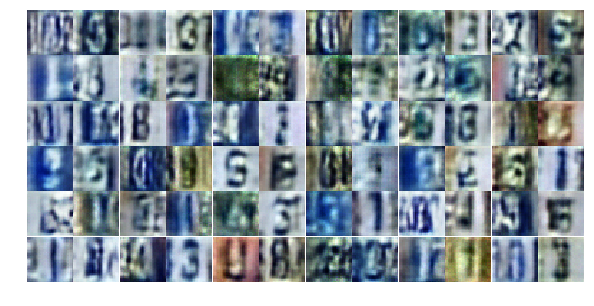

Epoch 5/25... Discriminator Loss: 0.3832... Generator Loss: 1.6028
Epoch 5/25... Discriminator Loss: 0.5563... Generator Loss: 1.2036
Epoch 5/25... Discriminator Loss: 1.5120... Generator Loss: 0.4263
Epoch 5/25... Discriminator Loss: 0.5562... Generator Loss: 1.3782
Epoch 5/25... Discriminator Loss: 0.8646... Generator Loss: 0.9178
Epoch 5/25... Discriminator Loss: 0.8929... Generator Loss: 0.8252
Epoch 5/25... Discriminator Loss: 0.7140... Generator Loss: 1.1850
Epoch 5/25... Discriminator Loss: 0.6525... Generator Loss: 1.0685
Epoch 5/25... Discriminator Loss: 1.1053... Generator Loss: 0.5427
Epoch 5/25... Discriminator Loss: 0.5857... Generator Loss: 1.3644


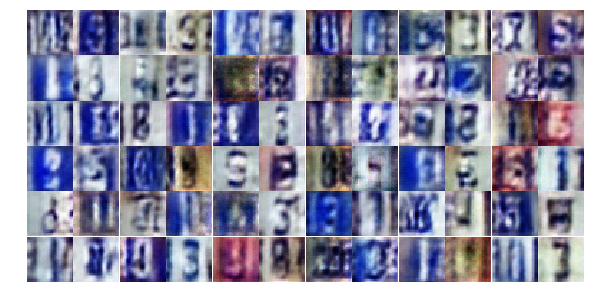

Epoch 5/25... Discriminator Loss: 1.1805... Generator Loss: 0.5595
Epoch 5/25... Discriminator Loss: 0.7324... Generator Loss: 1.5539
Epoch 5/25... Discriminator Loss: 1.1790... Generator Loss: 0.4604
Epoch 5/25... Discriminator Loss: 0.7733... Generator Loss: 0.9092
Epoch 5/25... Discriminator Loss: 0.7690... Generator Loss: 0.9261
Epoch 5/25... Discriminator Loss: 0.6980... Generator Loss: 1.7921
Epoch 6/25... Discriminator Loss: 0.6357... Generator Loss: 1.1520
Epoch 6/25... Discriminator Loss: 0.5509... Generator Loss: 1.2679
Epoch 6/25... Discriminator Loss: 0.6148... Generator Loss: 1.3049
Epoch 6/25... Discriminator Loss: 0.8452... Generator Loss: 0.8165


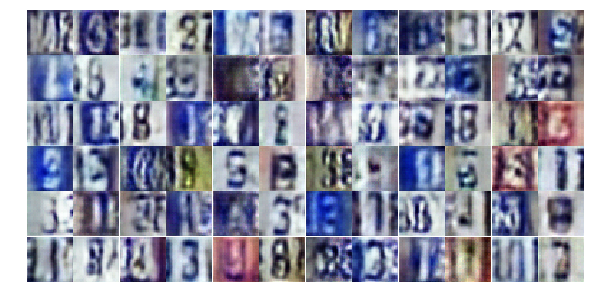

Epoch 6/25... Discriminator Loss: 0.4862... Generator Loss: 1.4015
Epoch 6/25... Discriminator Loss: 0.6500... Generator Loss: 1.1359
Epoch 6/25... Discriminator Loss: 0.6608... Generator Loss: 1.2655
Epoch 6/25... Discriminator Loss: 1.5880... Generator Loss: 0.3068
Epoch 6/25... Discriminator Loss: 0.8225... Generator Loss: 1.0832
Epoch 6/25... Discriminator Loss: 0.6242... Generator Loss: 1.1271
Epoch 6/25... Discriminator Loss: 0.5236... Generator Loss: 1.9253
Epoch 6/25... Discriminator Loss: 0.9342... Generator Loss: 0.6807
Epoch 6/25... Discriminator Loss: 0.4663... Generator Loss: 1.4576
Epoch 6/25... Discriminator Loss: 0.4050... Generator Loss: 1.8165


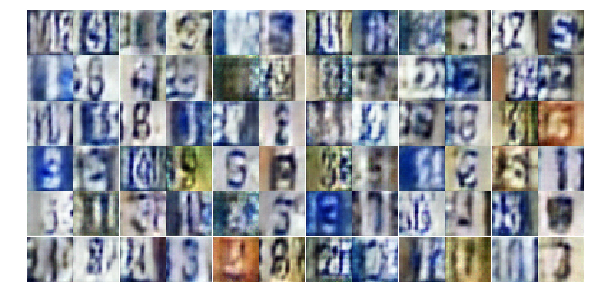

Epoch 6/25... Discriminator Loss: 0.3923... Generator Loss: 1.9019
Epoch 6/25... Discriminator Loss: 0.9386... Generator Loss: 1.8882
Epoch 6/25... Discriminator Loss: 1.0790... Generator Loss: 0.6230
Epoch 6/25... Discriminator Loss: 0.7807... Generator Loss: 0.9325
Epoch 6/25... Discriminator Loss: 0.5500... Generator Loss: 1.3826
Epoch 6/25... Discriminator Loss: 0.5042... Generator Loss: 1.4514
Epoch 6/25... Discriminator Loss: 0.8293... Generator Loss: 0.7827
Epoch 6/25... Discriminator Loss: 0.6454... Generator Loss: 1.1525
Epoch 6/25... Discriminator Loss: 0.8382... Generator Loss: 2.2707
Epoch 6/25... Discriminator Loss: 0.6408... Generator Loss: 1.3789


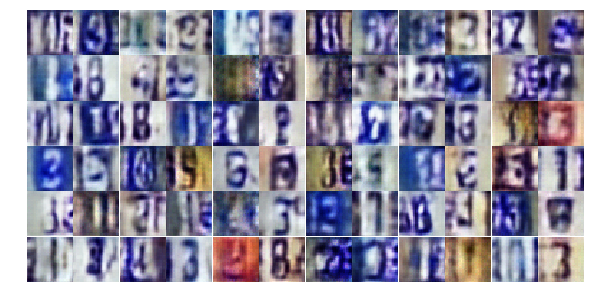

Epoch 6/25... Discriminator Loss: 1.1660... Generator Loss: 0.5080
Epoch 6/25... Discriminator Loss: 0.5511... Generator Loss: 1.6165
Epoch 6/25... Discriminator Loss: 1.4226... Generator Loss: 0.4026
Epoch 6/25... Discriminator Loss: 0.6548... Generator Loss: 1.0760
Epoch 6/25... Discriminator Loss: 0.5870... Generator Loss: 1.7445
Epoch 6/25... Discriminator Loss: 1.3042... Generator Loss: 0.5619
Epoch 6/25... Discriminator Loss: 0.4803... Generator Loss: 1.6517
Epoch 6/25... Discriminator Loss: 0.4478... Generator Loss: 1.6408
Epoch 6/25... Discriminator Loss: 0.6123... Generator Loss: 1.1704
Epoch 6/25... Discriminator Loss: 0.4654... Generator Loss: 1.4098


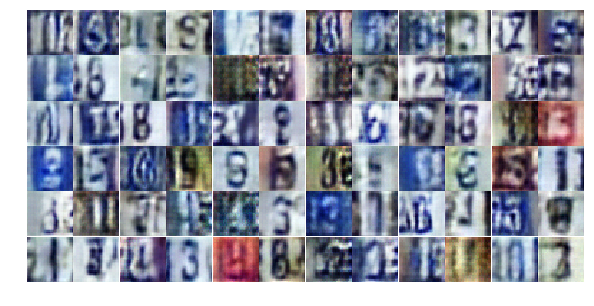

Epoch 6/25... Discriminator Loss: 0.5489... Generator Loss: 1.8641
Epoch 6/25... Discriminator Loss: 0.9537... Generator Loss: 2.3399
Epoch 6/25... Discriminator Loss: 0.8693... Generator Loss: 0.8716
Epoch 6/25... Discriminator Loss: 0.8272... Generator Loss: 0.7844
Epoch 6/25... Discriminator Loss: 0.8804... Generator Loss: 0.8360
Epoch 6/25... Discriminator Loss: 0.6111... Generator Loss: 1.1732
Epoch 6/25... Discriminator Loss: 0.7580... Generator Loss: 1.2208
Epoch 6/25... Discriminator Loss: 0.5059... Generator Loss: 1.4907
Epoch 6/25... Discriminator Loss: 0.8433... Generator Loss: 0.8873
Epoch 6/25... Discriminator Loss: 0.6520... Generator Loss: 0.9433


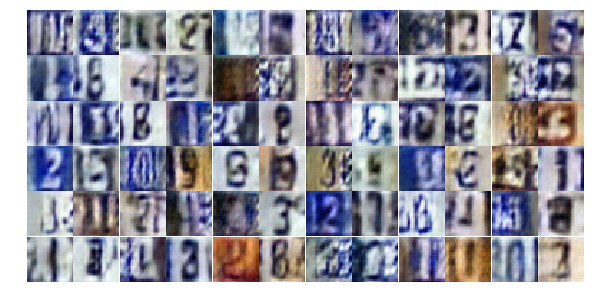

Epoch 6/25... Discriminator Loss: 0.6142... Generator Loss: 1.7361
Epoch 6/25... Discriminator Loss: 1.0702... Generator Loss: 1.6784
Epoch 6/25... Discriminator Loss: 0.7920... Generator Loss: 0.8975
Epoch 6/25... Discriminator Loss: 0.8771... Generator Loss: 1.7391
Epoch 6/25... Discriminator Loss: 0.8684... Generator Loss: 0.7958
Epoch 6/25... Discriminator Loss: 0.4924... Generator Loss: 1.2542
Epoch 6/25... Discriminator Loss: 0.8020... Generator Loss: 0.8187
Epoch 6/25... Discriminator Loss: 1.0418... Generator Loss: 0.5744
Epoch 6/25... Discriminator Loss: 0.5935... Generator Loss: 1.3443
Epoch 6/25... Discriminator Loss: 1.7447... Generator Loss: 0.2409


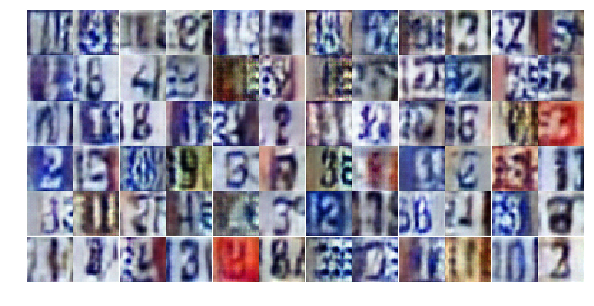

Epoch 6/25... Discriminator Loss: 0.8243... Generator Loss: 0.8604
Epoch 6/25... Discriminator Loss: 0.9100... Generator Loss: 0.7169
Epoch 6/25... Discriminator Loss: 0.7170... Generator Loss: 2.1329
Epoch 7/25... Discriminator Loss: 0.6540... Generator Loss: 1.0559
Epoch 7/25... Discriminator Loss: 0.5894... Generator Loss: 1.2642
Epoch 7/25... Discriminator Loss: 0.5651... Generator Loss: 1.4392
Epoch 7/25... Discriminator Loss: 0.5562... Generator Loss: 1.1624
Epoch 7/25... Discriminator Loss: 0.6136... Generator Loss: 1.6883
Epoch 7/25... Discriminator Loss: 0.5386... Generator Loss: 1.4781
Epoch 7/25... Discriminator Loss: 1.5614... Generator Loss: 0.3610


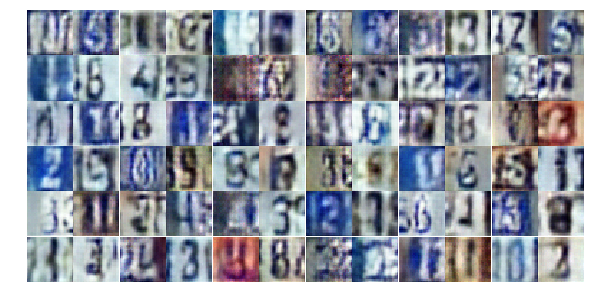

Epoch 7/25... Discriminator Loss: 0.5341... Generator Loss: 1.9294
Epoch 7/25... Discriminator Loss: 0.9406... Generator Loss: 0.7773
Epoch 7/25... Discriminator Loss: 0.6570... Generator Loss: 1.0631
Epoch 7/25... Discriminator Loss: 0.7843... Generator Loss: 1.0831
Epoch 7/25... Discriminator Loss: 0.5515... Generator Loss: 1.2514
Epoch 7/25... Discriminator Loss: 0.4363... Generator Loss: 1.4715
Epoch 7/25... Discriminator Loss: 0.7132... Generator Loss: 1.2652
Epoch 7/25... Discriminator Loss: 0.9601... Generator Loss: 0.8541
Epoch 7/25... Discriminator Loss: 0.6351... Generator Loss: 1.7867
Epoch 7/25... Discriminator Loss: 0.5504... Generator Loss: 1.1895


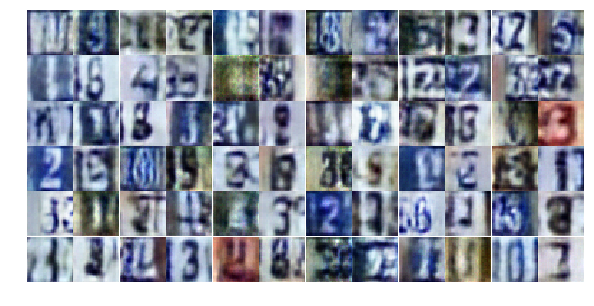

Epoch 7/25... Discriminator Loss: 0.5725... Generator Loss: 1.3267
Epoch 7/25... Discriminator Loss: 0.6753... Generator Loss: 1.0213
Epoch 7/25... Discriminator Loss: 0.7276... Generator Loss: 1.0239
Epoch 7/25... Discriminator Loss: 0.6138... Generator Loss: 1.2711
Epoch 7/25... Discriminator Loss: 0.3334... Generator Loss: 2.2963
Epoch 7/25... Discriminator Loss: 0.5665... Generator Loss: 1.5131
Epoch 7/25... Discriminator Loss: 0.7265... Generator Loss: 3.3018
Epoch 7/25... Discriminator Loss: 1.7674... Generator Loss: 0.2696
Epoch 7/25... Discriminator Loss: 0.4340... Generator Loss: 1.4410
Epoch 7/25... Discriminator Loss: 0.4402... Generator Loss: 1.5366


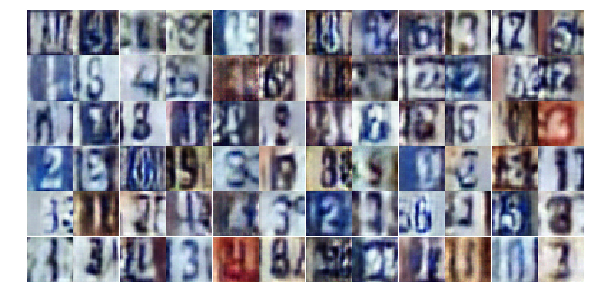

Epoch 7/25... Discriminator Loss: 0.8394... Generator Loss: 0.7707
Epoch 7/25... Discriminator Loss: 0.9023... Generator Loss: 0.7021
Epoch 7/25... Discriminator Loss: 0.6419... Generator Loss: 1.1434
Epoch 7/25... Discriminator Loss: 0.5787... Generator Loss: 1.1258
Epoch 7/25... Discriminator Loss: 0.5531... Generator Loss: 1.3289
Epoch 7/25... Discriminator Loss: 0.9720... Generator Loss: 0.6490
Epoch 7/25... Discriminator Loss: 0.7741... Generator Loss: 0.8415
Epoch 7/25... Discriminator Loss: 0.5706... Generator Loss: 1.2112
Epoch 7/25... Discriminator Loss: 0.9687... Generator Loss: 0.7681
Epoch 7/25... Discriminator Loss: 0.8106... Generator Loss: 3.4782


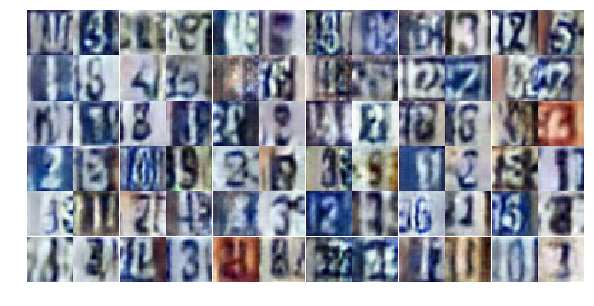

Epoch 7/25... Discriminator Loss: 1.2288... Generator Loss: 0.5149
Epoch 7/25... Discriminator Loss: 0.6525... Generator Loss: 1.9588
Epoch 7/25... Discriminator Loss: 0.3562... Generator Loss: 1.9526
Epoch 7/25... Discriminator Loss: 0.4596... Generator Loss: 1.5363
Epoch 7/25... Discriminator Loss: 0.6272... Generator Loss: 1.0896
Epoch 7/25... Discriminator Loss: 0.3922... Generator Loss: 2.7636
Epoch 7/25... Discriminator Loss: 0.4152... Generator Loss: 1.9435
Epoch 7/25... Discriminator Loss: 3.0981... Generator Loss: 0.0919
Epoch 7/25... Discriminator Loss: 0.5935... Generator Loss: 1.5336
Epoch 7/25... Discriminator Loss: 0.7538... Generator Loss: 0.9675


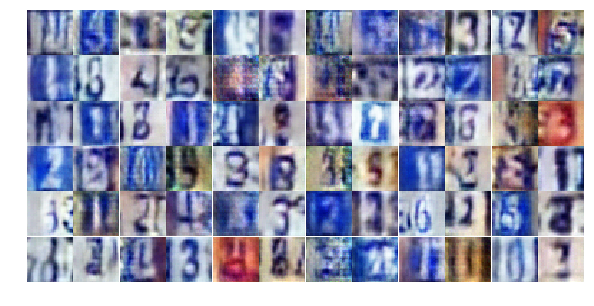

Epoch 7/25... Discriminator Loss: 0.9257... Generator Loss: 3.0992
Epoch 7/25... Discriminator Loss: 0.8731... Generator Loss: 0.9588
Epoch 7/25... Discriminator Loss: 0.8211... Generator Loss: 0.8964
Epoch 7/25... Discriminator Loss: 0.6276... Generator Loss: 1.1690
Epoch 7/25... Discriminator Loss: 0.5723... Generator Loss: 1.2194
Epoch 7/25... Discriminator Loss: 0.5930... Generator Loss: 1.5866
Epoch 7/25... Discriminator Loss: 1.6040... Generator Loss: 0.3045
Epoch 7/25... Discriminator Loss: 0.7399... Generator Loss: 1.1923
Epoch 7/25... Discriminator Loss: 0.6459... Generator Loss: 1.2191
Epoch 7/25... Discriminator Loss: 1.9011... Generator Loss: 0.2514


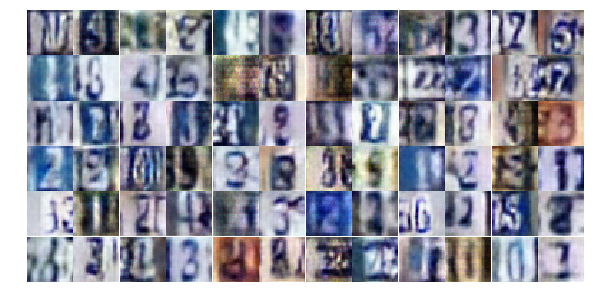

Epoch 7/25... Discriminator Loss: 0.6717... Generator Loss: 1.8912
Epoch 8/25... Discriminator Loss: 0.7999... Generator Loss: 1.0229
Epoch 8/25... Discriminator Loss: 1.0128... Generator Loss: 0.6013
Epoch 8/25... Discriminator Loss: 0.7399... Generator Loss: 1.0212
Epoch 8/25... Discriminator Loss: 0.7877... Generator Loss: 0.8381
Epoch 8/25... Discriminator Loss: 1.2116... Generator Loss: 0.5448
Epoch 8/25... Discriminator Loss: 0.7670... Generator Loss: 0.9181
Epoch 8/25... Discriminator Loss: 0.5052... Generator Loss: 1.6481
Epoch 8/25... Discriminator Loss: 0.6647... Generator Loss: 1.2061
Epoch 8/25... Discriminator Loss: 0.6733... Generator Loss: 1.0499


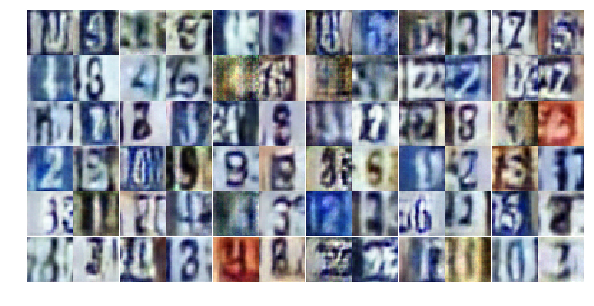

Epoch 8/25... Discriminator Loss: 0.5035... Generator Loss: 1.8072
Epoch 8/25... Discriminator Loss: 0.4260... Generator Loss: 2.0325
Epoch 8/25... Discriminator Loss: 0.6496... Generator Loss: 1.1692
Epoch 8/25... Discriminator Loss: 0.3015... Generator Loss: 2.2884
Epoch 8/25... Discriminator Loss: 1.6486... Generator Loss: 4.0170
Epoch 8/25... Discriminator Loss: 0.7209... Generator Loss: 1.2589
Epoch 8/25... Discriminator Loss: 0.8191... Generator Loss: 0.9272
Epoch 8/25... Discriminator Loss: 0.4586... Generator Loss: 1.6923
Epoch 8/25... Discriminator Loss: 0.9382... Generator Loss: 0.9403
Epoch 8/25... Discriminator Loss: 1.3063... Generator Loss: 0.4890


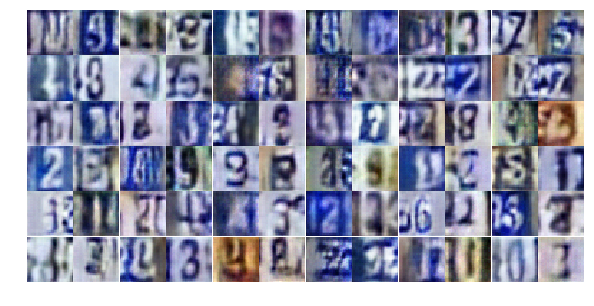

Epoch 8/25... Discriminator Loss: 0.3363... Generator Loss: 2.0865
Epoch 8/25... Discriminator Loss: 1.3924... Generator Loss: 0.4103
Epoch 8/25... Discriminator Loss: 0.7394... Generator Loss: 1.0664
Epoch 8/25... Discriminator Loss: 1.0247... Generator Loss: 0.6676
Epoch 8/25... Discriminator Loss: 0.4143... Generator Loss: 2.2592
Epoch 8/25... Discriminator Loss: 0.5345... Generator Loss: 1.2476
Epoch 8/25... Discriminator Loss: 0.7005... Generator Loss: 1.0953
Epoch 8/25... Discriminator Loss: 0.7030... Generator Loss: 0.9179
Epoch 8/25... Discriminator Loss: 0.6514... Generator Loss: 2.6486
Epoch 8/25... Discriminator Loss: 0.8383... Generator Loss: 0.7702


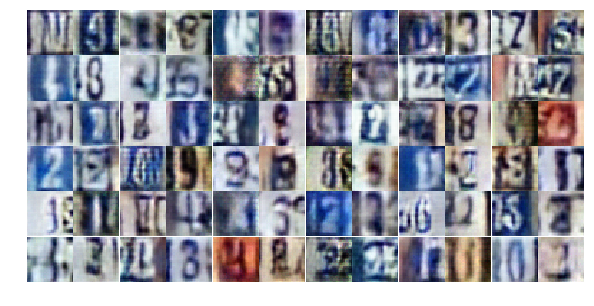

Epoch 8/25... Discriminator Loss: 0.7309... Generator Loss: 1.0144
Epoch 8/25... Discriminator Loss: 0.8703... Generator Loss: 0.7757
Epoch 8/25... Discriminator Loss: 0.4360... Generator Loss: 1.6995
Epoch 8/25... Discriminator Loss: 0.8095... Generator Loss: 0.8019
Epoch 8/25... Discriminator Loss: 0.6948... Generator Loss: 1.0894
Epoch 8/25... Discriminator Loss: 0.3715... Generator Loss: 1.8586
Epoch 8/25... Discriminator Loss: 0.5001... Generator Loss: 1.8354
Epoch 8/25... Discriminator Loss: 0.4735... Generator Loss: 1.4413
Epoch 8/25... Discriminator Loss: 0.6106... Generator Loss: 1.2078
Epoch 8/25... Discriminator Loss: 0.4406... Generator Loss: 1.7540


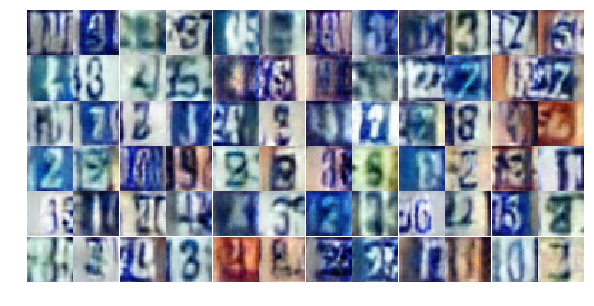

Epoch 8/25... Discriminator Loss: 0.8137... Generator Loss: 2.8205
Epoch 8/25... Discriminator Loss: 0.9832... Generator Loss: 0.6852
Epoch 8/25... Discriminator Loss: 1.1024... Generator Loss: 0.5064
Epoch 8/25... Discriminator Loss: 0.4792... Generator Loss: 1.4008
Epoch 8/25... Discriminator Loss: 1.1341... Generator Loss: 2.5840
Epoch 8/25... Discriminator Loss: 0.7055... Generator Loss: 1.3831
Epoch 8/25... Discriminator Loss: 0.3301... Generator Loss: 2.0527
Epoch 8/25... Discriminator Loss: 0.4928... Generator Loss: 1.6915
Epoch 8/25... Discriminator Loss: 0.4551... Generator Loss: 1.4644
Epoch 8/25... Discriminator Loss: 0.5204... Generator Loss: 1.2967


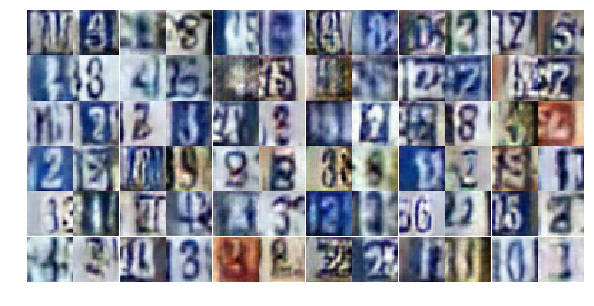

Epoch 8/25... Discriminator Loss: 0.4745... Generator Loss: 1.4128
Epoch 8/25... Discriminator Loss: 0.4847... Generator Loss: 1.3197
Epoch 8/25... Discriminator Loss: 0.7123... Generator Loss: 2.9444
Epoch 8/25... Discriminator Loss: 0.6225... Generator Loss: 1.0091
Epoch 8/25... Discriminator Loss: 0.4938... Generator Loss: 1.8863
Epoch 8/25... Discriminator Loss: 0.7518... Generator Loss: 0.9916
Epoch 8/25... Discriminator Loss: 0.6499... Generator Loss: 1.0092
Epoch 8/25... Discriminator Loss: 0.6079... Generator Loss: 2.2558
Epoch 9/25... Discriminator Loss: 1.1452... Generator Loss: 0.5509
Epoch 9/25... Discriminator Loss: 0.8193... Generator Loss: 0.8152


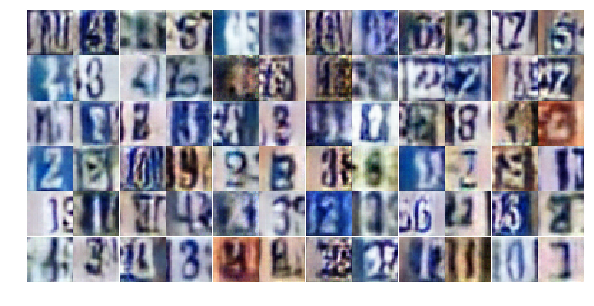

Epoch 9/25... Discriminator Loss: 0.8752... Generator Loss: 0.8096
Epoch 9/25... Discriminator Loss: 0.6835... Generator Loss: 2.1678
Epoch 9/25... Discriminator Loss: 0.7836... Generator Loss: 1.3288
Epoch 9/25... Discriminator Loss: 0.5964... Generator Loss: 1.4579
Epoch 9/25... Discriminator Loss: 1.8000... Generator Loss: 0.2822
Epoch 9/25... Discriminator Loss: 0.7457... Generator Loss: 1.6319
Epoch 9/25... Discriminator Loss: 0.7554... Generator Loss: 1.2583
Epoch 9/25... Discriminator Loss: 0.5269... Generator Loss: 1.4546
Epoch 9/25... Discriminator Loss: 1.3627... Generator Loss: 0.4134
Epoch 9/25... Discriminator Loss: 0.6405... Generator Loss: 1.3233


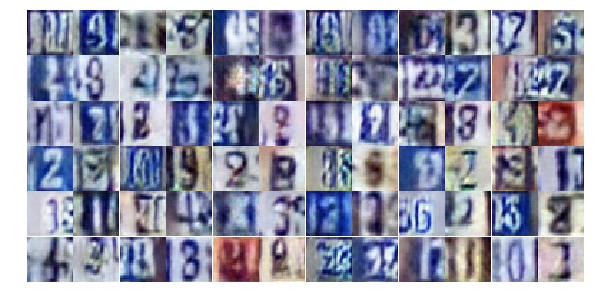

Epoch 9/25... Discriminator Loss: 0.8789... Generator Loss: 0.7633
Epoch 9/25... Discriminator Loss: 1.0799... Generator Loss: 0.6184
Epoch 9/25... Discriminator Loss: 0.7196... Generator Loss: 0.9765
Epoch 9/25... Discriminator Loss: 0.6537... Generator Loss: 1.0293
Epoch 9/25... Discriminator Loss: 0.5898... Generator Loss: 1.0814
Epoch 9/25... Discriminator Loss: 0.6410... Generator Loss: 1.1222
Epoch 9/25... Discriminator Loss: 1.0932... Generator Loss: 0.5578
Epoch 9/25... Discriminator Loss: 0.5188... Generator Loss: 1.5505
Epoch 9/25... Discriminator Loss: 1.1257... Generator Loss: 0.5205
Epoch 9/25... Discriminator Loss: 0.8225... Generator Loss: 0.9429


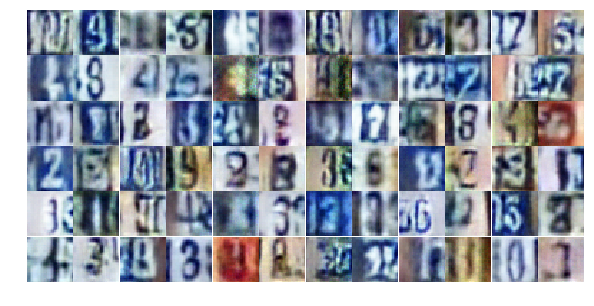

Epoch 9/25... Discriminator Loss: 1.2838... Generator Loss: 0.5296
Epoch 9/25... Discriminator Loss: 0.7016... Generator Loss: 1.1573
Epoch 9/25... Discriminator Loss: 0.6804... Generator Loss: 1.0525
Epoch 9/25... Discriminator Loss: 0.6292... Generator Loss: 1.1108
Epoch 9/25... Discriminator Loss: 0.5507... Generator Loss: 1.1398
Epoch 9/25... Discriminator Loss: 0.5698... Generator Loss: 1.3592
Epoch 9/25... Discriminator Loss: 1.0006... Generator Loss: 0.5948
Epoch 9/25... Discriminator Loss: 0.4913... Generator Loss: 1.3540
Epoch 9/25... Discriminator Loss: 0.7649... Generator Loss: 0.8146
Epoch 9/25... Discriminator Loss: 0.5366... Generator Loss: 1.3753


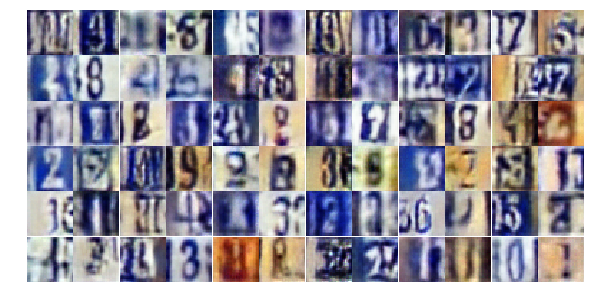

Epoch 9/25... Discriminator Loss: 0.5069... Generator Loss: 1.2785
Epoch 9/25... Discriminator Loss: 0.8942... Generator Loss: 0.7089
Epoch 9/25... Discriminator Loss: 1.4375... Generator Loss: 0.3702
Epoch 9/25... Discriminator Loss: 0.4747... Generator Loss: 2.1069
Epoch 9/25... Discriminator Loss: 0.8143... Generator Loss: 0.9826
Epoch 9/25... Discriminator Loss: 0.5517... Generator Loss: 1.3769
Epoch 9/25... Discriminator Loss: 0.5942... Generator Loss: 1.2678
Epoch 9/25... Discriminator Loss: 0.3507... Generator Loss: 1.9253
Epoch 9/25... Discriminator Loss: 1.0695... Generator Loss: 0.5892
Epoch 9/25... Discriminator Loss: 0.7089... Generator Loss: 0.9328


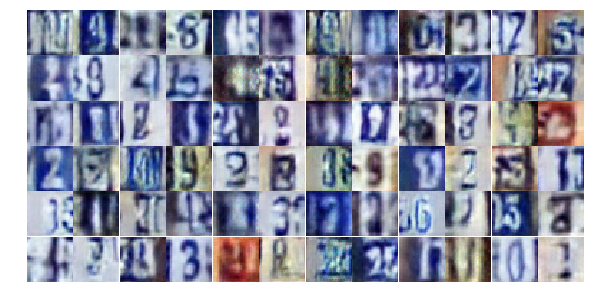

Epoch 9/25... Discriminator Loss: 0.4249... Generator Loss: 1.4939
Epoch 9/25... Discriminator Loss: 0.6448... Generator Loss: 1.0696
Epoch 9/25... Discriminator Loss: 0.6171... Generator Loss: 1.8615
Epoch 9/25... Discriminator Loss: 0.7963... Generator Loss: 0.8044
Epoch 9/25... Discriminator Loss: 0.2654... Generator Loss: 2.1870
Epoch 9/25... Discriminator Loss: 1.2622... Generator Loss: 0.4688
Epoch 9/25... Discriminator Loss: 0.6692... Generator Loss: 1.6589
Epoch 9/25... Discriminator Loss: 0.6431... Generator Loss: 1.0566
Epoch 9/25... Discriminator Loss: 0.4911... Generator Loss: 1.3823
Epoch 9/25... Discriminator Loss: 0.4775... Generator Loss: 1.4995


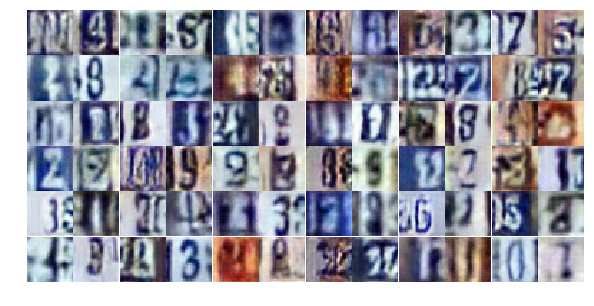

Epoch 9/25... Discriminator Loss: 2.2915... Generator Loss: 0.1563
Epoch 9/25... Discriminator Loss: 1.1464... Generator Loss: 1.3972
Epoch 9/25... Discriminator Loss: 0.9847... Generator Loss: 0.6935
Epoch 9/25... Discriminator Loss: 1.2542... Generator Loss: 0.4310
Epoch 9/25... Discriminator Loss: 0.5194... Generator Loss: 1.5583
Epoch 10/25... Discriminator Loss: 0.5608... Generator Loss: 1.2144
Epoch 10/25... Discriminator Loss: 0.6151... Generator Loss: 1.3471
Epoch 10/25... Discriminator Loss: 0.7109... Generator Loss: 0.9054
Epoch 10/25... Discriminator Loss: 0.6593... Generator Loss: 1.0275
Epoch 10/25... Discriminator Loss: 1.3588... Generator Loss: 0.3854


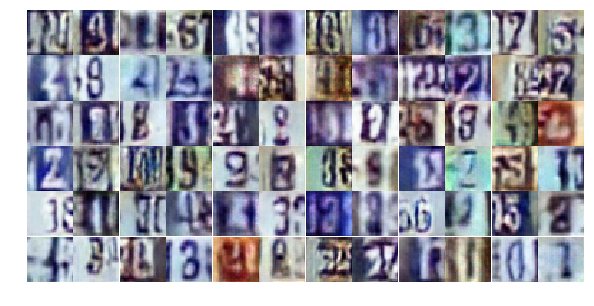

Epoch 10/25... Discriminator Loss: 1.1198... Generator Loss: 0.5809
Epoch 10/25... Discriminator Loss: 0.4767... Generator Loss: 2.2375
Epoch 10/25... Discriminator Loss: 0.6357... Generator Loss: 1.2891
Epoch 10/25... Discriminator Loss: 0.6365... Generator Loss: 1.6383
Epoch 10/25... Discriminator Loss: 0.6230... Generator Loss: 1.4034
Epoch 10/25... Discriminator Loss: 0.5946... Generator Loss: 1.4045
Epoch 10/25... Discriminator Loss: 0.5893... Generator Loss: 1.1460
Epoch 10/25... Discriminator Loss: 1.1956... Generator Loss: 0.4577
Epoch 10/25... Discriminator Loss: 0.9632... Generator Loss: 0.6481
Epoch 10/25... Discriminator Loss: 0.6174... Generator Loss: 1.4132


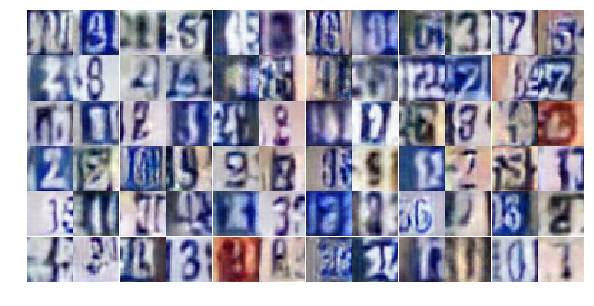

Epoch 10/25... Discriminator Loss: 0.7646... Generator Loss: 1.4875
Epoch 10/25... Discriminator Loss: 0.6869... Generator Loss: 1.0807
Epoch 10/25... Discriminator Loss: 0.7409... Generator Loss: 1.0550
Epoch 10/25... Discriminator Loss: 1.2520... Generator Loss: 0.5123
Epoch 10/25... Discriminator Loss: 0.5396... Generator Loss: 1.4662
Epoch 10/25... Discriminator Loss: 0.6277... Generator Loss: 1.0940
Epoch 10/25... Discriminator Loss: 0.8546... Generator Loss: 0.7485
Epoch 10/25... Discriminator Loss: 0.5097... Generator Loss: 1.7737
Epoch 10/25... Discriminator Loss: 0.5844... Generator Loss: 1.3064
Epoch 10/25... Discriminator Loss: 0.2570... Generator Loss: 2.5802


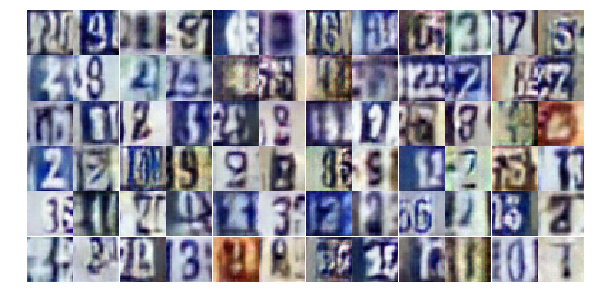

Epoch 10/25... Discriminator Loss: 1.3312... Generator Loss: 0.4024
Epoch 10/25... Discriminator Loss: 0.6483... Generator Loss: 1.0622
Epoch 10/25... Discriminator Loss: 0.4806... Generator Loss: 1.2638
Epoch 10/25... Discriminator Loss: 0.5923... Generator Loss: 2.6141
Epoch 10/25... Discriminator Loss: 0.8567... Generator Loss: 0.8600
Epoch 10/25... Discriminator Loss: 0.8577... Generator Loss: 0.8180
Epoch 10/25... Discriminator Loss: 0.4110... Generator Loss: 1.7578
Epoch 10/25... Discriminator Loss: 0.7444... Generator Loss: 0.9214
Epoch 10/25... Discriminator Loss: 0.8480... Generator Loss: 0.8000
Epoch 10/25... Discriminator Loss: 0.8399... Generator Loss: 0.9184


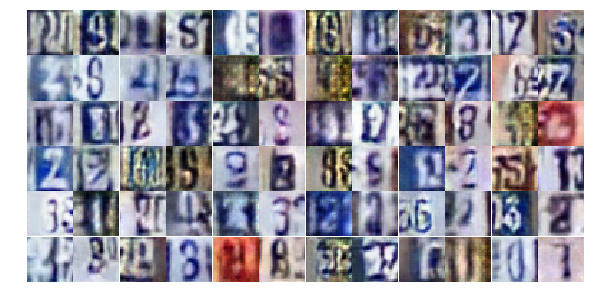

Epoch 10/25... Discriminator Loss: 0.5606... Generator Loss: 1.3794
Epoch 10/25... Discriminator Loss: 0.5211... Generator Loss: 1.4746
Epoch 10/25... Discriminator Loss: 0.4393... Generator Loss: 2.0146
Epoch 10/25... Discriminator Loss: 0.7050... Generator Loss: 1.1810
Epoch 10/25... Discriminator Loss: 0.5775... Generator Loss: 1.1814
Epoch 10/25... Discriminator Loss: 0.5806... Generator Loss: 1.1077
Epoch 10/25... Discriminator Loss: 0.6996... Generator Loss: 0.9478
Epoch 10/25... Discriminator Loss: 0.6376... Generator Loss: 1.0237
Epoch 10/25... Discriminator Loss: 0.5661... Generator Loss: 1.2455
Epoch 10/25... Discriminator Loss: 0.6634... Generator Loss: 2.5657


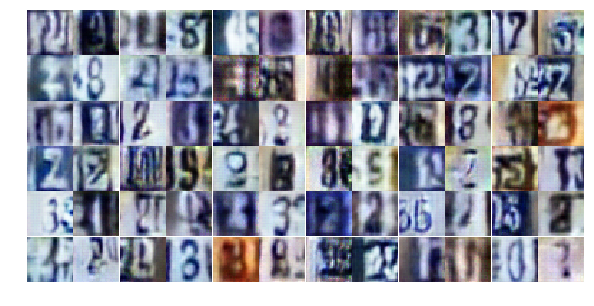

Epoch 10/25... Discriminator Loss: 1.2535... Generator Loss: 0.4753
Epoch 10/25... Discriminator Loss: 0.7623... Generator Loss: 0.8858
Epoch 10/25... Discriminator Loss: 0.8001... Generator Loss: 0.7746
Epoch 10/25... Discriminator Loss: 0.6951... Generator Loss: 1.1110
Epoch 10/25... Discriminator Loss: 0.4518... Generator Loss: 2.2620
Epoch 10/25... Discriminator Loss: 0.6671... Generator Loss: 2.6121
Epoch 10/25... Discriminator Loss: 0.8646... Generator Loss: 0.7860
Epoch 10/25... Discriminator Loss: 1.8384... Generator Loss: 3.8623
Epoch 10/25... Discriminator Loss: 0.7686... Generator Loss: 1.0861
Epoch 10/25... Discriminator Loss: 0.6292... Generator Loss: 1.1883


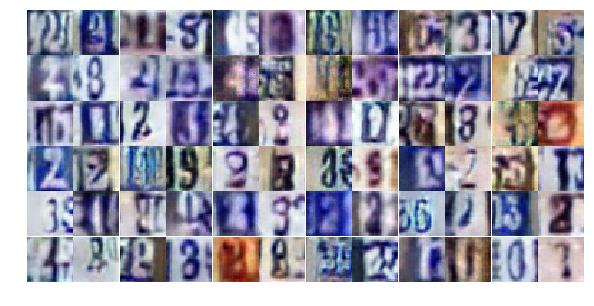

Epoch 10/25... Discriminator Loss: 0.7773... Generator Loss: 1.1243
Epoch 10/25... Discriminator Loss: 0.5532... Generator Loss: 1.2267
Epoch 10/25... Discriminator Loss: 0.4532... Generator Loss: 1.5317
Epoch 11/25... Discriminator Loss: 0.9537... Generator Loss: 0.7108
Epoch 11/25... Discriminator Loss: 0.7273... Generator Loss: 0.9103
Epoch 11/25... Discriminator Loss: 1.3270... Generator Loss: 0.4046
Epoch 11/25... Discriminator Loss: 0.6691... Generator Loss: 1.0400
Epoch 11/25... Discriminator Loss: 0.6320... Generator Loss: 1.5006
Epoch 11/25... Discriminator Loss: 1.5866... Generator Loss: 0.3385
Epoch 11/25... Discriminator Loss: 0.4654... Generator Loss: 1.7627


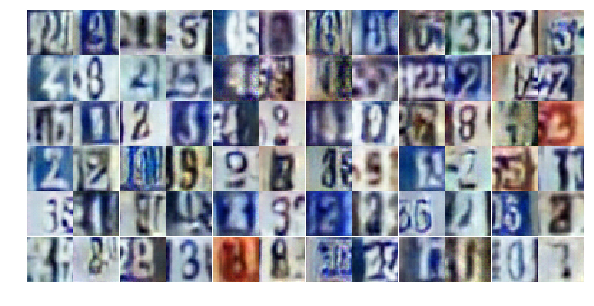

Epoch 11/25... Discriminator Loss: 0.4036... Generator Loss: 1.6837
Epoch 11/25... Discriminator Loss: 0.5725... Generator Loss: 1.4879
Epoch 11/25... Discriminator Loss: 0.4451... Generator Loss: 1.4734
Epoch 11/25... Discriminator Loss: 0.5336... Generator Loss: 1.2927
Epoch 11/25... Discriminator Loss: 0.6756... Generator Loss: 1.2650
Epoch 11/25... Discriminator Loss: 0.3246... Generator Loss: 2.2741
Epoch 11/25... Discriminator Loss: 0.6150... Generator Loss: 1.0870
Epoch 11/25... Discriminator Loss: 0.3621... Generator Loss: 3.0541
Epoch 11/25... Discriminator Loss: 1.3680... Generator Loss: 0.4707
Epoch 11/25... Discriminator Loss: 0.9435... Generator Loss: 0.7282


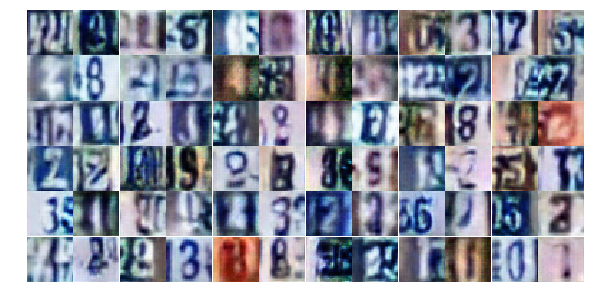

Epoch 11/25... Discriminator Loss: 0.7957... Generator Loss: 1.1894
Epoch 11/25... Discriminator Loss: 0.5289... Generator Loss: 1.7283
Epoch 11/25... Discriminator Loss: 0.7912... Generator Loss: 0.8708
Epoch 11/25... Discriminator Loss: 0.9377... Generator Loss: 0.7151
Epoch 11/25... Discriminator Loss: 0.3337... Generator Loss: 2.3457
Epoch 11/25... Discriminator Loss: 0.3899... Generator Loss: 1.7246
Epoch 11/25... Discriminator Loss: 0.4878... Generator Loss: 1.4850
Epoch 11/25... Discriminator Loss: 0.8659... Generator Loss: 0.8654
Epoch 11/25... Discriminator Loss: 0.4692... Generator Loss: 1.3523
Epoch 11/25... Discriminator Loss: 0.8818... Generator Loss: 0.7325


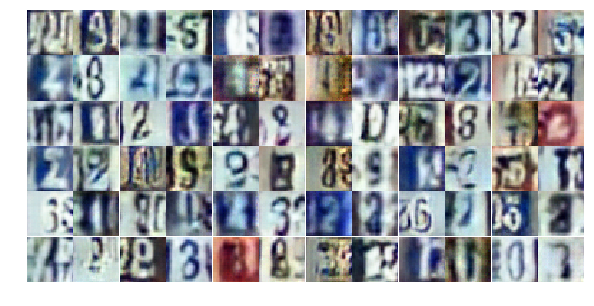

Epoch 11/25... Discriminator Loss: 0.9995... Generator Loss: 0.6389
Epoch 11/25... Discriminator Loss: 0.6080... Generator Loss: 1.1729
Epoch 11/25... Discriminator Loss: 1.0456... Generator Loss: 0.5905
Epoch 11/25... Discriminator Loss: 0.5136... Generator Loss: 1.3629
Epoch 11/25... Discriminator Loss: 0.6708... Generator Loss: 1.0262
Epoch 11/25... Discriminator Loss: 0.9619... Generator Loss: 0.7959
Epoch 11/25... Discriminator Loss: 1.6614... Generator Loss: 0.3101
Epoch 11/25... Discriminator Loss: 1.2927... Generator Loss: 0.4483
Epoch 11/25... Discriminator Loss: 0.4936... Generator Loss: 1.6295
Epoch 11/25... Discriminator Loss: 1.2437... Generator Loss: 0.4643


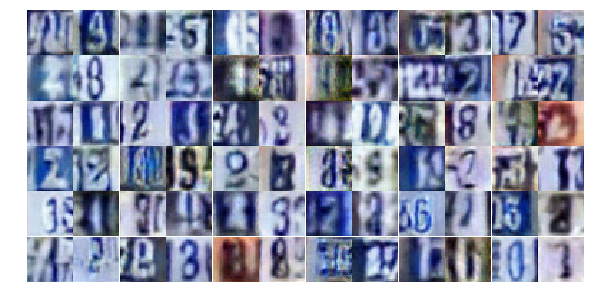

Epoch 11/25... Discriminator Loss: 0.4382... Generator Loss: 1.5325
Epoch 11/25... Discriminator Loss: 0.5536... Generator Loss: 1.3038
Epoch 11/25... Discriminator Loss: 0.6291... Generator Loss: 1.0804
Epoch 11/25... Discriminator Loss: 0.6992... Generator Loss: 1.0273
Epoch 11/25... Discriminator Loss: 0.8668... Generator Loss: 0.7381
Epoch 11/25... Discriminator Loss: 0.8305... Generator Loss: 0.8278
Epoch 11/25... Discriminator Loss: 0.2849... Generator Loss: 2.2768
Epoch 11/25... Discriminator Loss: 0.5684... Generator Loss: 1.8639
Epoch 11/25... Discriminator Loss: 1.6262... Generator Loss: 0.2864
Epoch 11/25... Discriminator Loss: 1.5009... Generator Loss: 0.3562


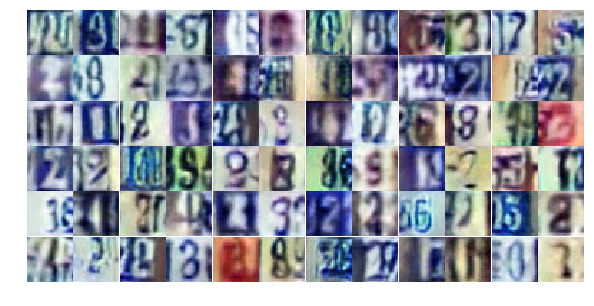

Epoch 11/25... Discriminator Loss: 1.0237... Generator Loss: 0.7265
Epoch 11/25... Discriminator Loss: 0.3474... Generator Loss: 1.8943
Epoch 11/25... Discriminator Loss: 0.5245... Generator Loss: 1.2747
Epoch 11/25... Discriminator Loss: 0.7548... Generator Loss: 0.8428
Epoch 11/25... Discriminator Loss: 0.9673... Generator Loss: 2.0736
Epoch 11/25... Discriminator Loss: 0.9355... Generator Loss: 0.7211
Epoch 11/25... Discriminator Loss: 0.9429... Generator Loss: 0.6625
Epoch 11/25... Discriminator Loss: 0.5214... Generator Loss: 1.3854
Epoch 11/25... Discriminator Loss: 0.8181... Generator Loss: 0.8150
Epoch 11/25... Discriminator Loss: 0.5901... Generator Loss: 1.0796


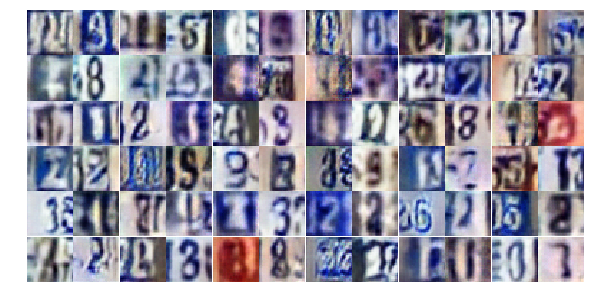

Epoch 12/25... Discriminator Loss: 0.6977... Generator Loss: 1.3244
Epoch 12/25... Discriminator Loss: 0.4906... Generator Loss: 1.2548
Epoch 12/25... Discriminator Loss: 2.6355... Generator Loss: 3.9298
Epoch 12/25... Discriminator Loss: 3.3273... Generator Loss: 0.1678
Epoch 12/25... Discriminator Loss: 0.7110... Generator Loss: 2.6081
Epoch 12/25... Discriminator Loss: 1.2797... Generator Loss: 0.4611
Epoch 12/25... Discriminator Loss: 0.6702... Generator Loss: 1.0766
Epoch 12/25... Discriminator Loss: 0.6343... Generator Loss: 1.3975
Epoch 12/25... Discriminator Loss: 0.6851... Generator Loss: 1.2138
Epoch 12/25... Discriminator Loss: 1.2086... Generator Loss: 0.5098


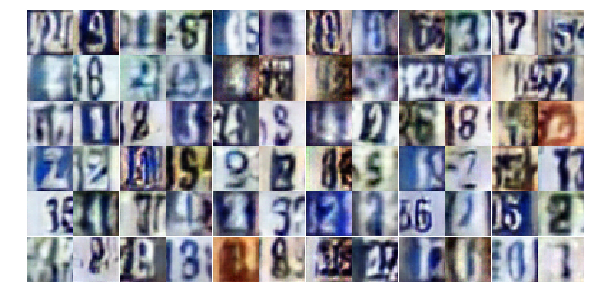

Epoch 12/25... Discriminator Loss: 0.6752... Generator Loss: 0.9753
Epoch 12/25... Discriminator Loss: 0.7950... Generator Loss: 1.1451
Epoch 12/25... Discriminator Loss: 0.4995... Generator Loss: 1.2631
Epoch 12/25... Discriminator Loss: 0.6154... Generator Loss: 1.4212
Epoch 12/25... Discriminator Loss: 0.5064... Generator Loss: 1.5715
Epoch 12/25... Discriminator Loss: 1.0248... Generator Loss: 0.5944
Epoch 12/25... Discriminator Loss: 1.4635... Generator Loss: 0.3657
Epoch 12/25... Discriminator Loss: 0.3406... Generator Loss: 1.7638
Epoch 12/25... Discriminator Loss: 0.4547... Generator Loss: 1.3915
Epoch 12/25... Discriminator Loss: 0.9197... Generator Loss: 0.7073


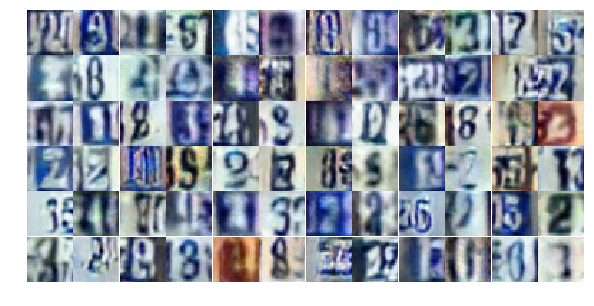

Epoch 12/25... Discriminator Loss: 0.3822... Generator Loss: 1.5771
Epoch 12/25... Discriminator Loss: 0.4804... Generator Loss: 1.7637
Epoch 12/25... Discriminator Loss: 0.6056... Generator Loss: 1.0993
Epoch 12/25... Discriminator Loss: 0.6221... Generator Loss: 1.9669
Epoch 12/25... Discriminator Loss: 0.4093... Generator Loss: 1.7279
Epoch 12/25... Discriminator Loss: 0.4749... Generator Loss: 1.5513
Epoch 12/25... Discriminator Loss: 0.6340... Generator Loss: 1.5774
Epoch 12/25... Discriminator Loss: 0.3530... Generator Loss: 2.0246
Epoch 12/25... Discriminator Loss: 0.5468... Generator Loss: 1.6034
Epoch 12/25... Discriminator Loss: 0.5088... Generator Loss: 1.4611


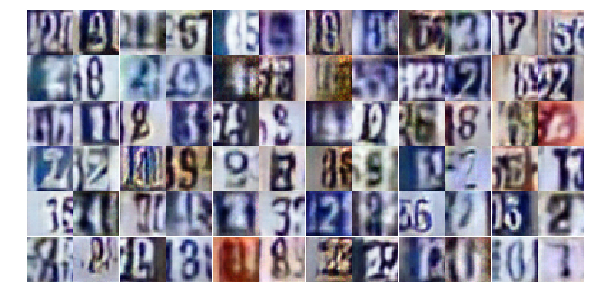

Epoch 12/25... Discriminator Loss: 0.5832... Generator Loss: 1.0452
Epoch 12/25... Discriminator Loss: 0.9347... Generator Loss: 0.6502
Epoch 12/25... Discriminator Loss: 0.6192... Generator Loss: 1.1584
Epoch 12/25... Discriminator Loss: 1.5795... Generator Loss: 0.3479
Epoch 12/25... Discriminator Loss: 0.5144... Generator Loss: 1.9091
Epoch 12/25... Discriminator Loss: 1.0897... Generator Loss: 0.5586
Epoch 12/25... Discriminator Loss: 0.8392... Generator Loss: 0.7713
Epoch 12/25... Discriminator Loss: 0.6923... Generator Loss: 0.9855
Epoch 12/25... Discriminator Loss: 0.4767... Generator Loss: 1.7036
Epoch 12/25... Discriminator Loss: 0.3480... Generator Loss: 2.1076


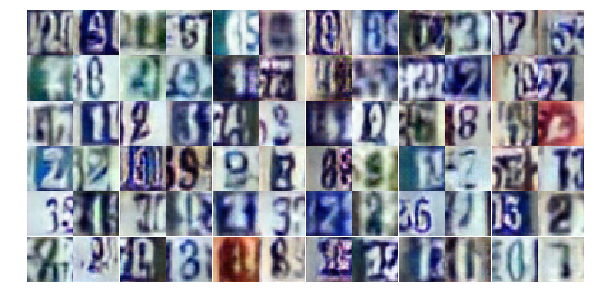

Epoch 12/25... Discriminator Loss: 0.5515... Generator Loss: 1.2789
Epoch 12/25... Discriminator Loss: 0.3877... Generator Loss: 1.7694
Epoch 12/25... Discriminator Loss: 0.3841... Generator Loss: 1.7283
Epoch 12/25... Discriminator Loss: 0.9836... Generator Loss: 1.1167
Epoch 12/25... Discriminator Loss: 1.4094... Generator Loss: 2.3662
Epoch 12/25... Discriminator Loss: 1.3301... Generator Loss: 0.4455
Epoch 12/25... Discriminator Loss: 1.0202... Generator Loss: 0.6844
Epoch 12/25... Discriminator Loss: 0.7760... Generator Loss: 1.0771
Epoch 12/25... Discriminator Loss: 0.5298... Generator Loss: 1.3624
Epoch 12/25... Discriminator Loss: 0.9647... Generator Loss: 0.6784


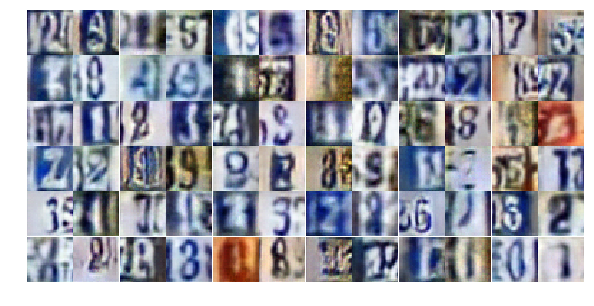

Epoch 12/25... Discriminator Loss: 1.0499... Generator Loss: 0.6181
Epoch 12/25... Discriminator Loss: 0.6709... Generator Loss: 1.0160
Epoch 12/25... Discriminator Loss: 0.5972... Generator Loss: 1.1563
Epoch 12/25... Discriminator Loss: 1.2175... Generator Loss: 0.5075
Epoch 12/25... Discriminator Loss: 0.6983... Generator Loss: 0.9734
Epoch 12/25... Discriminator Loss: 0.9612... Generator Loss: 2.2002
Epoch 12/25... Discriminator Loss: 0.6571... Generator Loss: 1.0720
Epoch 13/25... Discriminator Loss: 0.4779... Generator Loss: 1.3720
Epoch 13/25... Discriminator Loss: 0.4694... Generator Loss: 1.3871
Epoch 13/25... Discriminator Loss: 0.8476... Generator Loss: 0.8892


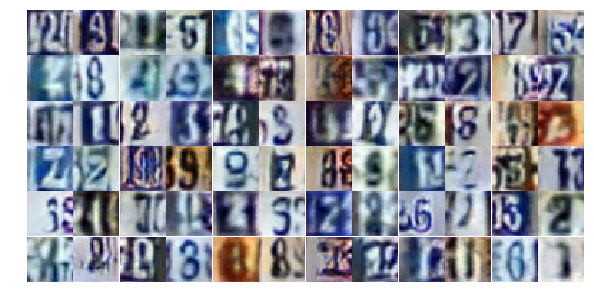

Epoch 13/25... Discriminator Loss: 0.3983... Generator Loss: 1.6557
Epoch 13/25... Discriminator Loss: 0.5293... Generator Loss: 1.3650
Epoch 13/25... Discriminator Loss: 0.6531... Generator Loss: 1.2736
Epoch 13/25... Discriminator Loss: 1.3255... Generator Loss: 0.5173
Epoch 13/25... Discriminator Loss: 0.7987... Generator Loss: 0.7969
Epoch 13/25... Discriminator Loss: 0.5195... Generator Loss: 1.3156
Epoch 13/25... Discriminator Loss: 0.3948... Generator Loss: 1.5452
Epoch 13/25... Discriminator Loss: 0.9041... Generator Loss: 0.6905
Epoch 13/25... Discriminator Loss: 0.4786... Generator Loss: 1.2850
Epoch 13/25... Discriminator Loss: 0.3777... Generator Loss: 2.3209


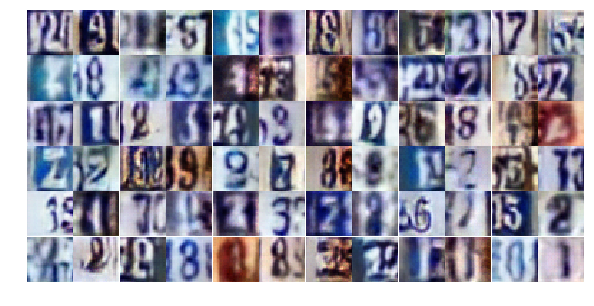

Epoch 13/25... Discriminator Loss: 4.9672... Generator Loss: 6.8539
Epoch 13/25... Discriminator Loss: 0.6859... Generator Loss: 1.2063
Epoch 13/25... Discriminator Loss: 1.0271... Generator Loss: 0.7109
Epoch 13/25... Discriminator Loss: 0.7751... Generator Loss: 0.9381
Epoch 13/25... Discriminator Loss: 0.4236... Generator Loss: 1.8205
Epoch 13/25... Discriminator Loss: 0.6939... Generator Loss: 1.0374
Epoch 13/25... Discriminator Loss: 0.7295... Generator Loss: 1.1748
Epoch 13/25... Discriminator Loss: 1.1791... Generator Loss: 0.5078
Epoch 13/25... Discriminator Loss: 0.7301... Generator Loss: 0.9546
Epoch 13/25... Discriminator Loss: 0.8932... Generator Loss: 0.7742


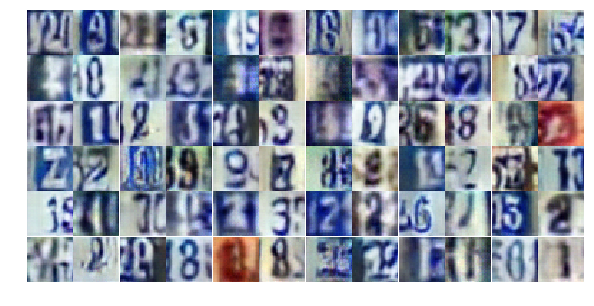

Epoch 13/25... Discriminator Loss: 0.6128... Generator Loss: 1.1303
Epoch 13/25... Discriminator Loss: 0.6239... Generator Loss: 1.5596
Epoch 13/25... Discriminator Loss: 0.6425... Generator Loss: 1.2680
Epoch 13/25... Discriminator Loss: 0.6912... Generator Loss: 1.0252
Epoch 13/25... Discriminator Loss: 0.6248... Generator Loss: 1.0964
Epoch 13/25... Discriminator Loss: 0.8167... Generator Loss: 0.8349
Epoch 13/25... Discriminator Loss: 0.6300... Generator Loss: 1.2419
Epoch 13/25... Discriminator Loss: 0.6393... Generator Loss: 1.0815
Epoch 13/25... Discriminator Loss: 0.4885... Generator Loss: 1.3448
Epoch 13/25... Discriminator Loss: 0.5802... Generator Loss: 1.4189


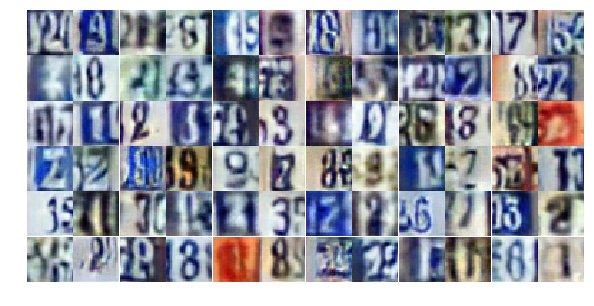

Epoch 13/25... Discriminator Loss: 0.8026... Generator Loss: 0.7995
Epoch 13/25... Discriminator Loss: 0.8777... Generator Loss: 1.5464
Epoch 13/25... Discriminator Loss: 1.2386... Generator Loss: 0.4984
Epoch 13/25... Discriminator Loss: 1.1641... Generator Loss: 0.5623
Epoch 13/25... Discriminator Loss: 0.5639... Generator Loss: 1.4225
Epoch 13/25... Discriminator Loss: 0.5529... Generator Loss: 1.9191
Epoch 13/25... Discriminator Loss: 0.5876... Generator Loss: 1.3669
Epoch 13/25... Discriminator Loss: 0.9700... Generator Loss: 0.6943
Epoch 13/25... Discriminator Loss: 0.6419... Generator Loss: 1.9156
Epoch 13/25... Discriminator Loss: 0.6887... Generator Loss: 0.9429


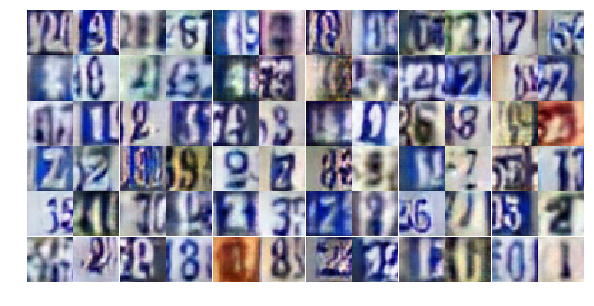

Epoch 13/25... Discriminator Loss: 0.6050... Generator Loss: 1.1469
Epoch 13/25... Discriminator Loss: 0.5826... Generator Loss: 1.2138
Epoch 13/25... Discriminator Loss: 0.7266... Generator Loss: 0.8829
Epoch 13/25... Discriminator Loss: 0.6071... Generator Loss: 1.1783
Epoch 13/25... Discriminator Loss: 0.7518... Generator Loss: 0.9526
Epoch 13/25... Discriminator Loss: 0.5989... Generator Loss: 1.3197
Epoch 13/25... Discriminator Loss: 0.7315... Generator Loss: 0.9738
Epoch 13/25... Discriminator Loss: 0.9918... Generator Loss: 0.6220
Epoch 13/25... Discriminator Loss: 0.8732... Generator Loss: 0.7394
Epoch 13/25... Discriminator Loss: 1.4623... Generator Loss: 0.3791


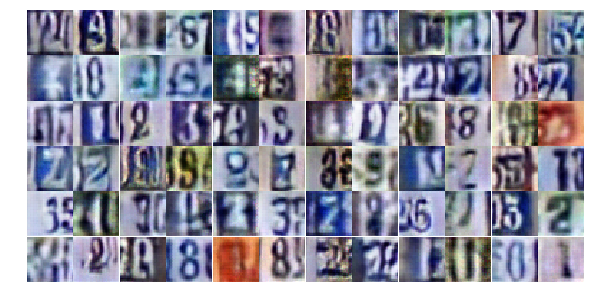

Epoch 13/25... Discriminator Loss: 0.3954... Generator Loss: 2.2127
Epoch 13/25... Discriminator Loss: 0.9366... Generator Loss: 0.7343
Epoch 13/25... Discriminator Loss: 0.5887... Generator Loss: 1.2062
Epoch 13/25... Discriminator Loss: 0.9362... Generator Loss: 0.6903
Epoch 14/25... Discriminator Loss: 0.7100... Generator Loss: 0.9464
Epoch 14/25... Discriminator Loss: 0.7084... Generator Loss: 1.2603
Epoch 14/25... Discriminator Loss: 0.8309... Generator Loss: 0.8192
Epoch 14/25... Discriminator Loss: 0.6124... Generator Loss: 1.9790
Epoch 14/25... Discriminator Loss: 0.5275... Generator Loss: 1.4090
Epoch 14/25... Discriminator Loss: 0.6945... Generator Loss: 0.9564


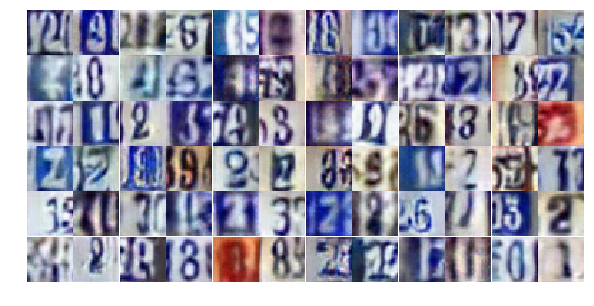

Epoch 14/25... Discriminator Loss: 0.7308... Generator Loss: 1.7877
Epoch 14/25... Discriminator Loss: 0.9190... Generator Loss: 0.6691
Epoch 14/25... Discriminator Loss: 0.6348... Generator Loss: 1.1148
Epoch 14/25... Discriminator Loss: 0.5977... Generator Loss: 1.2828
Epoch 14/25... Discriminator Loss: 1.1074... Generator Loss: 0.5431
Epoch 14/25... Discriminator Loss: 0.5253... Generator Loss: 1.1468
Epoch 14/25... Discriminator Loss: 0.4340... Generator Loss: 1.7260
Epoch 14/25... Discriminator Loss: 1.3438... Generator Loss: 0.4034
Epoch 14/25... Discriminator Loss: 1.3084... Generator Loss: 0.5435
Epoch 14/25... Discriminator Loss: 1.9355... Generator Loss: 0.2111


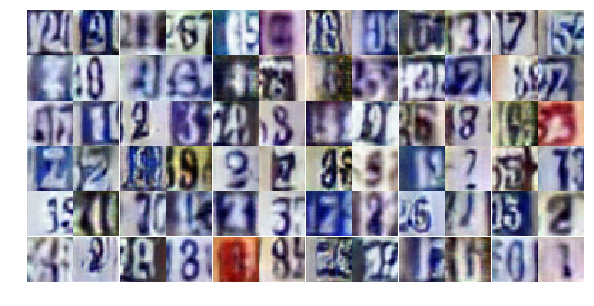

Epoch 14/25... Discriminator Loss: 0.3764... Generator Loss: 1.8608
Epoch 14/25... Discriminator Loss: 0.7274... Generator Loss: 2.5829
Epoch 14/25... Discriminator Loss: 0.8030... Generator Loss: 1.0247
Epoch 14/25... Discriminator Loss: 0.4533... Generator Loss: 1.5253
Epoch 14/25... Discriminator Loss: 0.8188... Generator Loss: 0.8713
Epoch 14/25... Discriminator Loss: 1.2251... Generator Loss: 2.1483
Epoch 14/25... Discriminator Loss: 1.3378... Generator Loss: 0.4767
Epoch 14/25... Discriminator Loss: 0.7708... Generator Loss: 0.8916
Epoch 14/25... Discriminator Loss: 0.5619... Generator Loss: 1.2030
Epoch 14/25... Discriminator Loss: 0.3683... Generator Loss: 2.2504


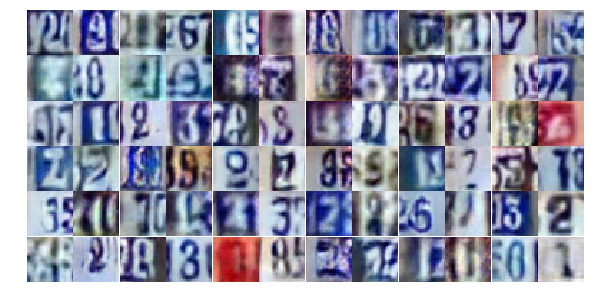

Epoch 14/25... Discriminator Loss: 0.9425... Generator Loss: 0.6969
Epoch 14/25... Discriminator Loss: 0.4944... Generator Loss: 1.2747
Epoch 14/25... Discriminator Loss: 0.6417... Generator Loss: 1.0979
Epoch 14/25... Discriminator Loss: 0.4047... Generator Loss: 1.6239
Epoch 14/25... Discriminator Loss: 0.6761... Generator Loss: 0.9940
Epoch 14/25... Discriminator Loss: 0.9292... Generator Loss: 0.7525
Epoch 14/25... Discriminator Loss: 0.9658... Generator Loss: 0.6790
Epoch 14/25... Discriminator Loss: 0.4745... Generator Loss: 1.3301
Epoch 14/25... Discriminator Loss: 0.3882... Generator Loss: 2.5581
Epoch 14/25... Discriminator Loss: 0.8385... Generator Loss: 0.7621


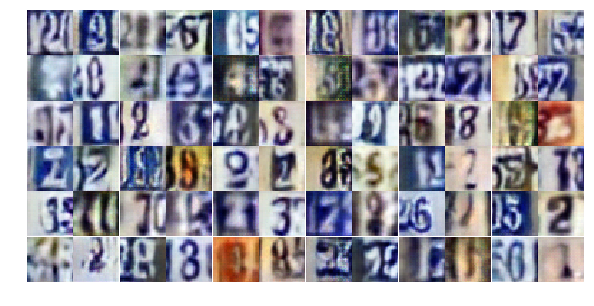

Epoch 14/25... Discriminator Loss: 1.1066... Generator Loss: 0.5139
Epoch 14/25... Discriminator Loss: 0.7116... Generator Loss: 1.1507
Epoch 14/25... Discriminator Loss: 1.0767... Generator Loss: 0.5794
Epoch 14/25... Discriminator Loss: 0.8836... Generator Loss: 0.7280
Epoch 14/25... Discriminator Loss: 0.9907... Generator Loss: 0.6812
Epoch 14/25... Discriminator Loss: 0.5822... Generator Loss: 1.2978
Epoch 14/25... Discriminator Loss: 0.6315... Generator Loss: 1.1609
Epoch 14/25... Discriminator Loss: 0.6322... Generator Loss: 1.0704
Epoch 14/25... Discriminator Loss: 0.9564... Generator Loss: 0.6710
Epoch 14/25... Discriminator Loss: 1.2312... Generator Loss: 0.5080


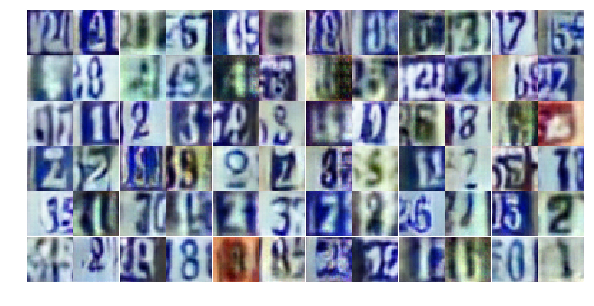

Epoch 14/25... Discriminator Loss: 1.0595... Generator Loss: 1.6520
Epoch 14/25... Discriminator Loss: 1.3163... Generator Loss: 0.3893
Epoch 14/25... Discriminator Loss: 0.6336... Generator Loss: 1.1098
Epoch 14/25... Discriminator Loss: 1.2174... Generator Loss: 0.5829
Epoch 14/25... Discriminator Loss: 0.6944... Generator Loss: 0.9846
Epoch 14/25... Discriminator Loss: 0.6590... Generator Loss: 1.2977
Epoch 14/25... Discriminator Loss: 0.5905... Generator Loss: 1.5697
Epoch 14/25... Discriminator Loss: 0.6778... Generator Loss: 1.3197
Epoch 14/25... Discriminator Loss: 1.1301... Generator Loss: 0.5113
Epoch 14/25... Discriminator Loss: 0.9302... Generator Loss: 0.7331


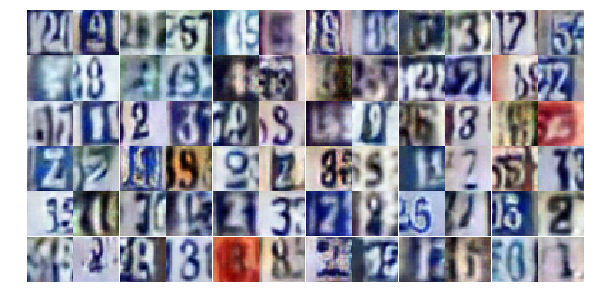

Epoch 14/25... Discriminator Loss: 0.9948... Generator Loss: 0.6827
Epoch 14/25... Discriminator Loss: 1.1421... Generator Loss: 0.5638
Epoch 15/25... Discriminator Loss: 0.9069... Generator Loss: 0.7192
Epoch 15/25... Discriminator Loss: 0.5200... Generator Loss: 1.4131
Epoch 15/25... Discriminator Loss: 0.5912... Generator Loss: 1.1697
Epoch 15/25... Discriminator Loss: 0.9968... Generator Loss: 0.6673
Epoch 15/25... Discriminator Loss: 0.7228... Generator Loss: 0.9268
Epoch 15/25... Discriminator Loss: 0.6438... Generator Loss: 2.5693
Epoch 15/25... Discriminator Loss: 2.2161... Generator Loss: 0.3322
Epoch 15/25... Discriminator Loss: 0.8800... Generator Loss: 0.8008


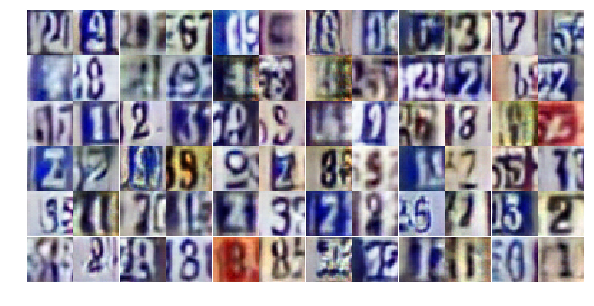

Epoch 15/25... Discriminator Loss: 0.8721... Generator Loss: 0.8816
Epoch 15/25... Discriminator Loss: 0.9214... Generator Loss: 1.0481
Epoch 15/25... Discriminator Loss: 0.9609... Generator Loss: 0.6731
Epoch 15/25... Discriminator Loss: 0.7615... Generator Loss: 0.8915
Epoch 15/25... Discriminator Loss: 0.8971... Generator Loss: 0.8965
Epoch 15/25... Discriminator Loss: 0.7158... Generator Loss: 1.9102
Epoch 15/25... Discriminator Loss: 0.6961... Generator Loss: 1.0343
Epoch 15/25... Discriminator Loss: 0.7041... Generator Loss: 1.1759
Epoch 15/25... Discriminator Loss: 0.4992... Generator Loss: 1.6844
Epoch 15/25... Discriminator Loss: 1.0941... Generator Loss: 0.5981


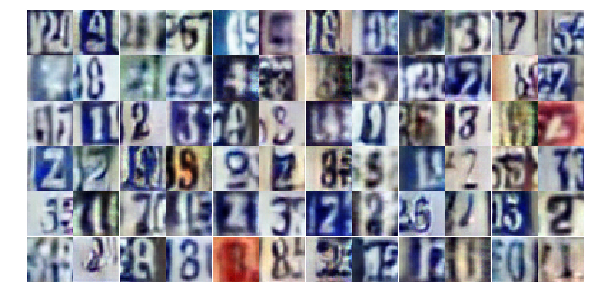

Epoch 15/25... Discriminator Loss: 0.9433... Generator Loss: 0.8071
Epoch 15/25... Discriminator Loss: 0.7587... Generator Loss: 0.9970
Epoch 15/25... Discriminator Loss: 0.5777... Generator Loss: 1.3869
Epoch 15/25... Discriminator Loss: 0.7523... Generator Loss: 0.9284
Epoch 15/25... Discriminator Loss: 0.8484... Generator Loss: 1.6689
Epoch 15/25... Discriminator Loss: 0.7457... Generator Loss: 0.9980
Epoch 15/25... Discriminator Loss: 0.7041... Generator Loss: 1.0863
Epoch 15/25... Discriminator Loss: 0.7607... Generator Loss: 0.9153
Epoch 15/25... Discriminator Loss: 0.5723... Generator Loss: 1.1172
Epoch 15/25... Discriminator Loss: 1.1982... Generator Loss: 0.5299


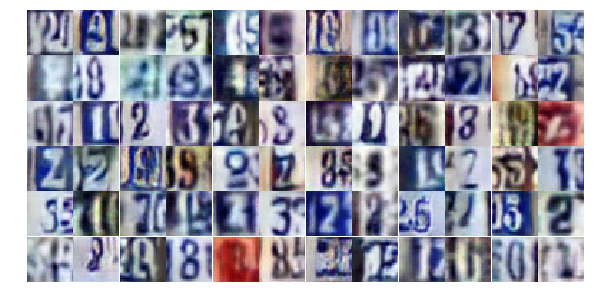

Epoch 15/25... Discriminator Loss: 0.7188... Generator Loss: 0.9740
Epoch 15/25... Discriminator Loss: 1.4571... Generator Loss: 0.4148
Epoch 15/25... Discriminator Loss: 0.5918... Generator Loss: 1.0645
Epoch 15/25... Discriminator Loss: 0.6659... Generator Loss: 1.6183
Epoch 15/25... Discriminator Loss: 0.5161... Generator Loss: 1.5009
Epoch 15/25... Discriminator Loss: 0.6803... Generator Loss: 2.4040
Epoch 15/25... Discriminator Loss: 0.4736... Generator Loss: 1.5573
Epoch 15/25... Discriminator Loss: 1.7808... Generator Loss: 2.0222
Epoch 15/25... Discriminator Loss: 0.6408... Generator Loss: 1.4453
Epoch 15/25... Discriminator Loss: 0.8029... Generator Loss: 0.8783


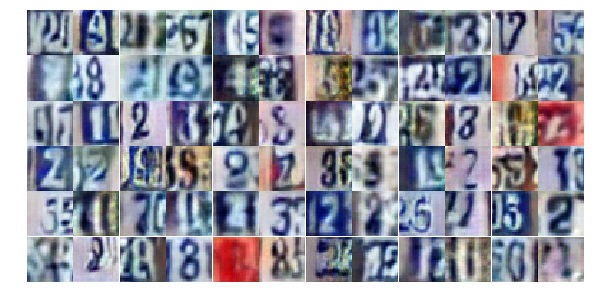

Epoch 15/25... Discriminator Loss: 0.6069... Generator Loss: 1.1016
Epoch 15/25... Discriminator Loss: 1.3448... Generator Loss: 0.4405
Epoch 15/25... Discriminator Loss: 0.7131... Generator Loss: 0.9405
Epoch 15/25... Discriminator Loss: 0.4501... Generator Loss: 1.6643
Epoch 15/25... Discriminator Loss: 0.4211... Generator Loss: 1.5183
Epoch 15/25... Discriminator Loss: 1.2692... Generator Loss: 0.4735
Epoch 15/25... Discriminator Loss: 0.3978... Generator Loss: 1.7629
Epoch 15/25... Discriminator Loss: 0.8231... Generator Loss: 1.0432
Epoch 15/25... Discriminator Loss: 1.1604... Generator Loss: 0.4865
Epoch 15/25... Discriminator Loss: 0.9070... Generator Loss: 0.8253


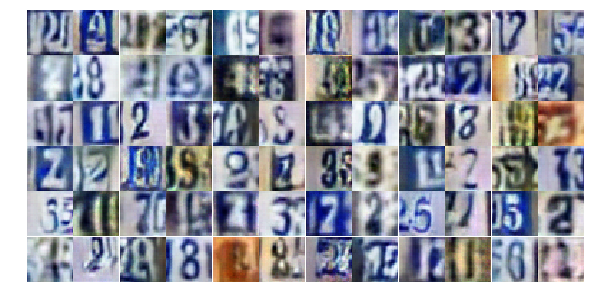

Epoch 15/25... Discriminator Loss: 0.9122... Generator Loss: 0.7667
Epoch 15/25... Discriminator Loss: 1.0480... Generator Loss: 0.6128
Epoch 15/25... Discriminator Loss: 0.8083... Generator Loss: 3.2356
Epoch 15/25... Discriminator Loss: 1.3455... Generator Loss: 0.4077
Epoch 15/25... Discriminator Loss: 0.4593... Generator Loss: 1.4647
Epoch 15/25... Discriminator Loss: 0.9333... Generator Loss: 0.7014
Epoch 15/25... Discriminator Loss: 0.8042... Generator Loss: 0.8714
Epoch 15/25... Discriminator Loss: 0.6326... Generator Loss: 1.1821
Epoch 15/25... Discriminator Loss: 1.9162... Generator Loss: 0.2486
Epoch 16/25... Discriminator Loss: 1.1247... Generator Loss: 0.5501


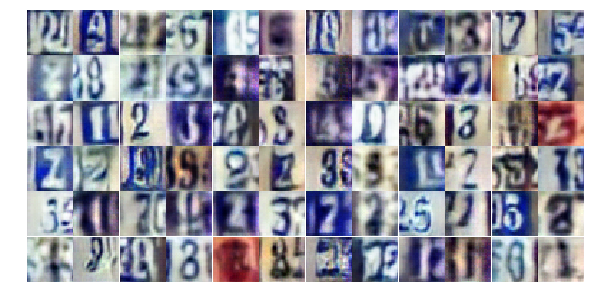

Epoch 16/25... Discriminator Loss: 0.5848... Generator Loss: 1.2291
Epoch 16/25... Discriminator Loss: 0.8170... Generator Loss: 0.9615
Epoch 16/25... Discriminator Loss: 0.7788... Generator Loss: 0.9026
Epoch 16/25... Discriminator Loss: 0.6164... Generator Loss: 1.1306
Epoch 16/25... Discriminator Loss: 0.5310... Generator Loss: 1.8482
Epoch 16/25... Discriminator Loss: 0.6789... Generator Loss: 1.8421
Epoch 16/25... Discriminator Loss: 1.7740... Generator Loss: 0.3006
Epoch 16/25... Discriminator Loss: 0.6522... Generator Loss: 1.0545
Epoch 16/25... Discriminator Loss: 0.7065... Generator Loss: 0.9358
Epoch 16/25... Discriminator Loss: 0.5970... Generator Loss: 1.0716


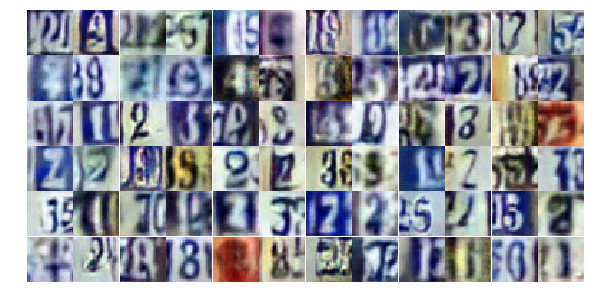

Epoch 16/25... Discriminator Loss: 1.3995... Generator Loss: 0.3799
Epoch 16/25... Discriminator Loss: 0.5010... Generator Loss: 1.3668
Epoch 16/25... Discriminator Loss: 0.6276... Generator Loss: 1.2230
Epoch 16/25... Discriminator Loss: 1.3554... Generator Loss: 0.4318
Epoch 16/25... Discriminator Loss: 0.4668... Generator Loss: 2.0584
Epoch 16/25... Discriminator Loss: 0.9321... Generator Loss: 0.6796
Epoch 16/25... Discriminator Loss: 2.2114... Generator Loss: 0.2032
Epoch 16/25... Discriminator Loss: 0.5630... Generator Loss: 1.2757
Epoch 16/25... Discriminator Loss: 0.5441... Generator Loss: 1.3854
Epoch 16/25... Discriminator Loss: 0.7985... Generator Loss: 0.8235


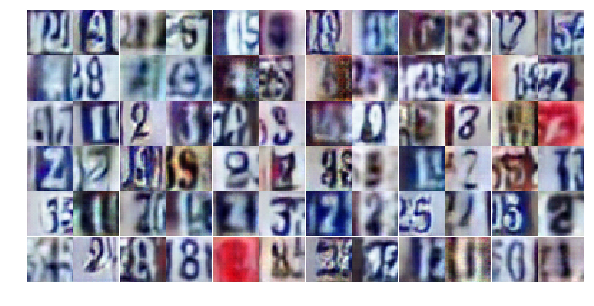

Epoch 16/25... Discriminator Loss: 0.5975... Generator Loss: 1.2975
Epoch 16/25... Discriminator Loss: 0.4554... Generator Loss: 1.4640
Epoch 16/25... Discriminator Loss: 0.6624... Generator Loss: 1.0545
Epoch 16/25... Discriminator Loss: 0.7422... Generator Loss: 0.9351
Epoch 16/25... Discriminator Loss: 0.5934... Generator Loss: 1.1877
Epoch 16/25... Discriminator Loss: 0.6935... Generator Loss: 1.0929
Epoch 16/25... Discriminator Loss: 0.6869... Generator Loss: 1.0520
Epoch 16/25... Discriminator Loss: 0.5915... Generator Loss: 1.4194
Epoch 16/25... Discriminator Loss: 1.0107... Generator Loss: 1.2199
Epoch 16/25... Discriminator Loss: 0.7345... Generator Loss: 0.9235


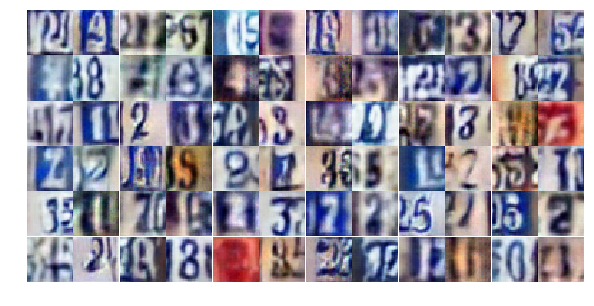

Epoch 16/25... Discriminator Loss: 0.6283... Generator Loss: 1.0874
Epoch 16/25... Discriminator Loss: 0.4590... Generator Loss: 1.4592
Epoch 16/25... Discriminator Loss: 0.6252... Generator Loss: 1.0840
Epoch 16/25... Discriminator Loss: 0.6915... Generator Loss: 1.0267
Epoch 16/25... Discriminator Loss: 0.7539... Generator Loss: 1.2056
Epoch 16/25... Discriminator Loss: 2.1955... Generator Loss: 3.2559
Epoch 16/25... Discriminator Loss: 1.0752... Generator Loss: 0.7394
Epoch 16/25... Discriminator Loss: 1.3732... Generator Loss: 0.3804
Epoch 16/25... Discriminator Loss: 1.0028... Generator Loss: 0.6687
Epoch 16/25... Discriminator Loss: 0.5348... Generator Loss: 1.2402


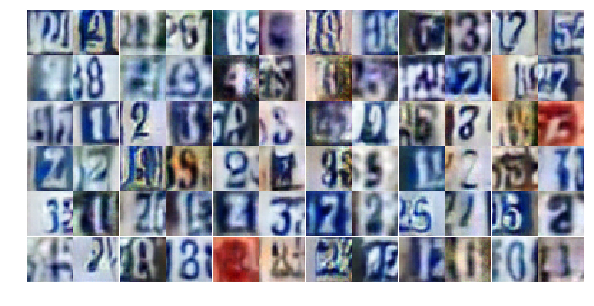

Epoch 16/25... Discriminator Loss: 0.6007... Generator Loss: 1.1446
Epoch 16/25... Discriminator Loss: 0.5391... Generator Loss: 1.4741
Epoch 16/25... Discriminator Loss: 0.8668... Generator Loss: 0.7915
Epoch 16/25... Discriminator Loss: 1.4684... Generator Loss: 3.5511
Epoch 16/25... Discriminator Loss: 1.4481... Generator Loss: 0.4008
Epoch 16/25... Discriminator Loss: 1.1593... Generator Loss: 0.5665
Epoch 16/25... Discriminator Loss: 0.4992... Generator Loss: 1.4957
Epoch 16/25... Discriminator Loss: 0.7683... Generator Loss: 0.9176
Epoch 16/25... Discriminator Loss: 0.5014... Generator Loss: 1.3997
Epoch 16/25... Discriminator Loss: 0.9071... Generator Loss: 0.7094


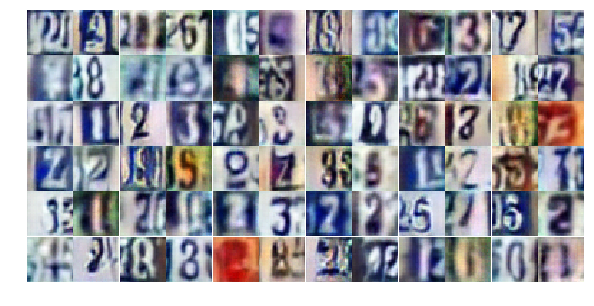

Epoch 16/25... Discriminator Loss: 0.9054... Generator Loss: 1.1331
Epoch 16/25... Discriminator Loss: 0.6668... Generator Loss: 1.6471
Epoch 16/25... Discriminator Loss: 1.3473... Generator Loss: 0.4217
Epoch 16/25... Discriminator Loss: 0.6070... Generator Loss: 1.1721
Epoch 16/25... Discriminator Loss: 0.6555... Generator Loss: 1.0367
Epoch 16/25... Discriminator Loss: 0.4954... Generator Loss: 1.2611
Epoch 17/25... Discriminator Loss: 0.7790... Generator Loss: 0.8652
Epoch 17/25... Discriminator Loss: 1.1860... Generator Loss: 0.5117
Epoch 17/25... Discriminator Loss: 0.6899... Generator Loss: 1.0421
Epoch 17/25... Discriminator Loss: 0.4925... Generator Loss: 1.5038


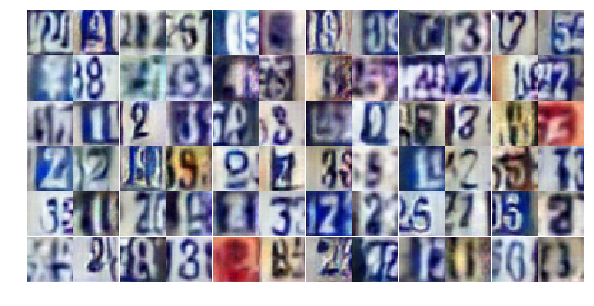

Epoch 17/25... Discriminator Loss: 0.5026... Generator Loss: 1.2504
Epoch 17/25... Discriminator Loss: 0.4797... Generator Loss: 1.3402
Epoch 17/25... Discriminator Loss: 1.2592... Generator Loss: 0.4950
Epoch 17/25... Discriminator Loss: 0.4132... Generator Loss: 2.5746
Epoch 17/25... Discriminator Loss: 1.0943... Generator Loss: 0.5619
Epoch 17/25... Discriminator Loss: 0.9774... Generator Loss: 0.6588
Epoch 17/25... Discriminator Loss: 0.5776... Generator Loss: 1.7368
Epoch 17/25... Discriminator Loss: 0.5912... Generator Loss: 1.1054
Epoch 17/25... Discriminator Loss: 0.3834... Generator Loss: 1.7766
Epoch 17/25... Discriminator Loss: 0.5998... Generator Loss: 1.5588


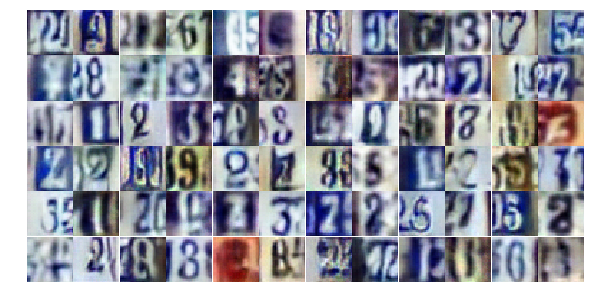

Epoch 17/25... Discriminator Loss: 1.0166... Generator Loss: 0.6179
Epoch 17/25... Discriminator Loss: 0.7895... Generator Loss: 0.8703
Epoch 17/25... Discriminator Loss: 0.6536... Generator Loss: 1.0672
Epoch 17/25... Discriminator Loss: 1.5673... Generator Loss: 0.4192
Epoch 17/25... Discriminator Loss: 0.5791... Generator Loss: 2.1990
Epoch 17/25... Discriminator Loss: 0.8810... Generator Loss: 0.8402
Epoch 17/25... Discriminator Loss: 0.5670... Generator Loss: 1.3274
Epoch 17/25... Discriminator Loss: 0.5680... Generator Loss: 1.2756
Epoch 17/25... Discriminator Loss: 0.8487... Generator Loss: 0.8151
Epoch 17/25... Discriminator Loss: 0.6128... Generator Loss: 1.1814


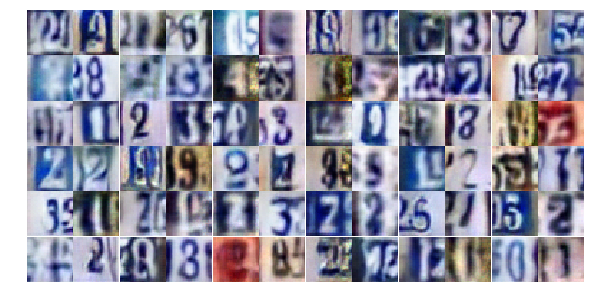

Epoch 17/25... Discriminator Loss: 1.4142... Generator Loss: 0.4139
Epoch 17/25... Discriminator Loss: 0.4643... Generator Loss: 1.5059
Epoch 17/25... Discriminator Loss: 0.5469... Generator Loss: 1.1676
Epoch 17/25... Discriminator Loss: 1.0462... Generator Loss: 0.6408
Epoch 17/25... Discriminator Loss: 2.4210... Generator Loss: 0.1433
Epoch 17/25... Discriminator Loss: 1.1498... Generator Loss: 0.4879
Epoch 17/25... Discriminator Loss: 0.6417... Generator Loss: 1.1044
Epoch 17/25... Discriminator Loss: 0.6812... Generator Loss: 1.0278
Epoch 17/25... Discriminator Loss: 0.9512... Generator Loss: 0.8679
Epoch 17/25... Discriminator Loss: 0.4253... Generator Loss: 1.6876


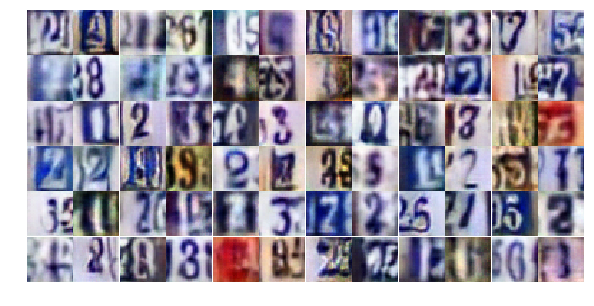

Epoch 17/25... Discriminator Loss: 0.6829... Generator Loss: 1.2372
Epoch 17/25... Discriminator Loss: 0.9514... Generator Loss: 0.7717
Epoch 17/25... Discriminator Loss: 0.4593... Generator Loss: 2.0041
Epoch 17/25... Discriminator Loss: 0.6710... Generator Loss: 1.1226
Epoch 17/25... Discriminator Loss: 1.1293... Generator Loss: 0.5305
Epoch 17/25... Discriminator Loss: 0.7874... Generator Loss: 0.8643
Epoch 17/25... Discriminator Loss: 0.7318... Generator Loss: 1.0032
Epoch 17/25... Discriminator Loss: 0.5256... Generator Loss: 1.5680
Epoch 17/25... Discriminator Loss: 0.3044... Generator Loss: 2.0371
Epoch 17/25... Discriminator Loss: 1.0033... Generator Loss: 0.6484


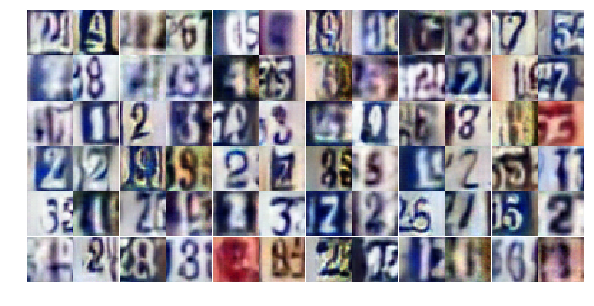

Epoch 17/25... Discriminator Loss: 0.9349... Generator Loss: 0.8010
Epoch 17/25... Discriminator Loss: 0.3295... Generator Loss: 2.3690
Epoch 17/25... Discriminator Loss: 1.7216... Generator Loss: 0.3195
Epoch 17/25... Discriminator Loss: 0.5061... Generator Loss: 1.9060
Epoch 17/25... Discriminator Loss: 0.9697... Generator Loss: 0.7201
Epoch 17/25... Discriminator Loss: 0.8610... Generator Loss: 0.7565
Epoch 17/25... Discriminator Loss: 0.6923... Generator Loss: 0.9129
Epoch 17/25... Discriminator Loss: 0.7138... Generator Loss: 0.9935
Epoch 17/25... Discriminator Loss: 0.7676... Generator Loss: 0.8913
Epoch 17/25... Discriminator Loss: 0.8388... Generator Loss: 1.2844


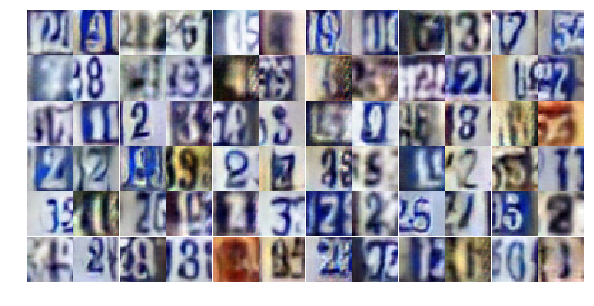

Epoch 17/25... Discriminator Loss: 0.6494... Generator Loss: 1.3711
Epoch 17/25... Discriminator Loss: 0.8566... Generator Loss: 1.6554
Epoch 17/25... Discriminator Loss: 0.3095... Generator Loss: 2.7804
Epoch 17/25... Discriminator Loss: 0.5729... Generator Loss: 1.2771
Epoch 18/25... Discriminator Loss: 1.1874... Generator Loss: 0.5169
Epoch 18/25... Discriminator Loss: 1.1083... Generator Loss: 0.5613
Epoch 18/25... Discriminator Loss: 0.7195... Generator Loss: 0.9702
Epoch 18/25... Discriminator Loss: 0.6436... Generator Loss: 0.9741
Epoch 18/25... Discriminator Loss: 1.1512... Generator Loss: 0.5233
Epoch 18/25... Discriminator Loss: 0.8731... Generator Loss: 0.8537


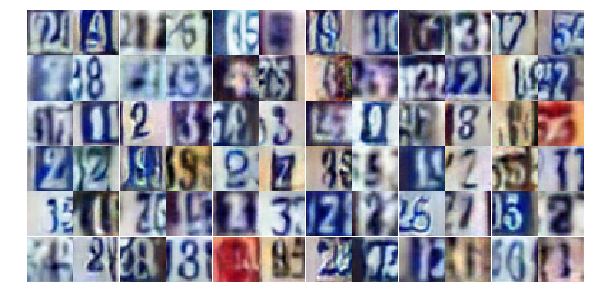

Epoch 18/25... Discriminator Loss: 0.3668... Generator Loss: 1.7525
Epoch 18/25... Discriminator Loss: 0.9837... Generator Loss: 0.6836
Epoch 18/25... Discriminator Loss: 0.7565... Generator Loss: 0.8045
Epoch 18/25... Discriminator Loss: 0.4390... Generator Loss: 1.6186
Epoch 18/25... Discriminator Loss: 0.6921... Generator Loss: 0.9699
Epoch 18/25... Discriminator Loss: 0.7772... Generator Loss: 0.9555
Epoch 18/25... Discriminator Loss: 0.6505... Generator Loss: 1.0800
Epoch 18/25... Discriminator Loss: 0.8267... Generator Loss: 0.8299
Epoch 18/25... Discriminator Loss: 0.9930... Generator Loss: 2.9332
Epoch 18/25... Discriminator Loss: 1.0219... Generator Loss: 0.8284


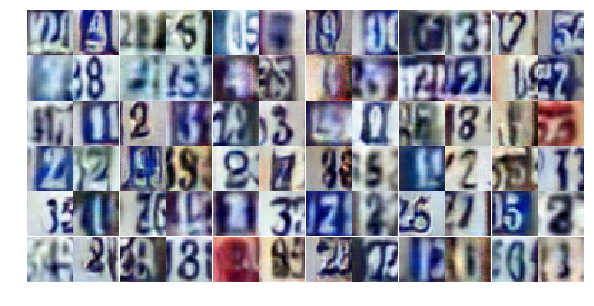

Epoch 18/25... Discriminator Loss: 0.8333... Generator Loss: 0.8143
Epoch 18/25... Discriminator Loss: 0.8825... Generator Loss: 0.7366
Epoch 18/25... Discriminator Loss: 1.3231... Generator Loss: 0.4458
Epoch 18/25... Discriminator Loss: 0.7221... Generator Loss: 1.0076
Epoch 18/25... Discriminator Loss: 0.5755... Generator Loss: 1.1536
Epoch 18/25... Discriminator Loss: 0.9507... Generator Loss: 0.6828
Epoch 18/25... Discriminator Loss: 0.9613... Generator Loss: 0.7213
Epoch 18/25... Discriminator Loss: 1.1534... Generator Loss: 0.5592
Epoch 18/25... Discriminator Loss: 0.8638... Generator Loss: 0.8312
Epoch 18/25... Discriminator Loss: 0.8092... Generator Loss: 0.8819


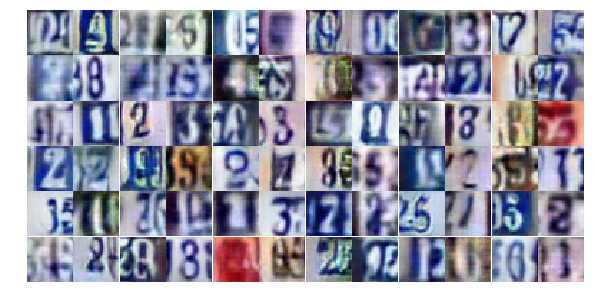

Epoch 18/25... Discriminator Loss: 0.4359... Generator Loss: 1.4872
Epoch 18/25... Discriminator Loss: 0.7957... Generator Loss: 2.0628
Epoch 18/25... Discriminator Loss: 1.1899... Generator Loss: 0.5033
Epoch 18/25... Discriminator Loss: 0.9356... Generator Loss: 0.7142
Epoch 18/25... Discriminator Loss: 1.0479... Generator Loss: 0.6294
Epoch 18/25... Discriminator Loss: 0.6223... Generator Loss: 1.1744
Epoch 18/25... Discriminator Loss: 0.8777... Generator Loss: 0.8217
Epoch 18/25... Discriminator Loss: 0.5140... Generator Loss: 1.3198
Epoch 18/25... Discriminator Loss: 0.8147... Generator Loss: 0.7793
Epoch 18/25... Discriminator Loss: 0.5838... Generator Loss: 1.1757


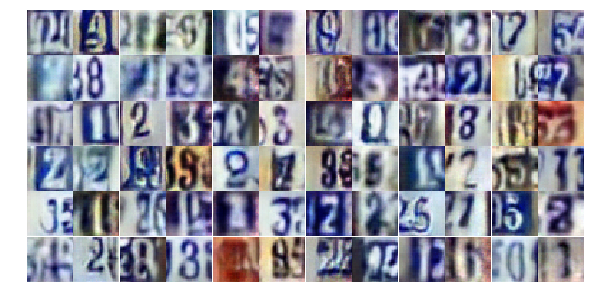

Epoch 18/25... Discriminator Loss: 0.7065... Generator Loss: 1.3460
Epoch 18/25... Discriminator Loss: 0.5781... Generator Loss: 1.2118
Epoch 18/25... Discriminator Loss: 0.7450... Generator Loss: 0.9455
Epoch 18/25... Discriminator Loss: 0.6887... Generator Loss: 1.0457
Epoch 18/25... Discriminator Loss: 1.1133... Generator Loss: 0.6134
Epoch 18/25... Discriminator Loss: 0.5267... Generator Loss: 1.2509
Epoch 18/25... Discriminator Loss: 0.8513... Generator Loss: 0.7550
Epoch 18/25... Discriminator Loss: 2.3752... Generator Loss: 0.2018
Epoch 18/25... Discriminator Loss: 1.1309... Generator Loss: 0.6300
Epoch 18/25... Discriminator Loss: 0.4101... Generator Loss: 1.5534


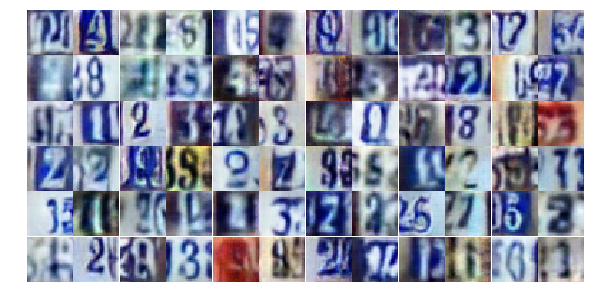

Epoch 18/25... Discriminator Loss: 0.5091... Generator Loss: 1.3814
Epoch 18/25... Discriminator Loss: 0.5923... Generator Loss: 1.1060
Epoch 18/25... Discriminator Loss: 0.7140... Generator Loss: 1.3162
Epoch 18/25... Discriminator Loss: 0.9736... Generator Loss: 0.6858
Epoch 18/25... Discriminator Loss: 0.5663... Generator Loss: 1.2332
Epoch 18/25... Discriminator Loss: 0.8399... Generator Loss: 0.7662
Epoch 18/25... Discriminator Loss: 0.6876... Generator Loss: 0.9203
Epoch 18/25... Discriminator Loss: 0.6620... Generator Loss: 1.6255
Epoch 18/25... Discriminator Loss: 1.2485... Generator Loss: 0.4570
Epoch 18/25... Discriminator Loss: 0.9957... Generator Loss: 0.7824


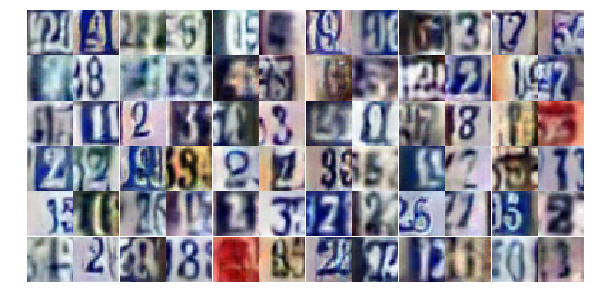

Epoch 18/25... Discriminator Loss: 0.4575... Generator Loss: 2.4247
Epoch 19/25... Discriminator Loss: 0.9215... Generator Loss: 0.7256
Epoch 19/25... Discriminator Loss: 1.0441... Generator Loss: 0.6168
Epoch 19/25... Discriminator Loss: 0.9709... Generator Loss: 0.7176
Epoch 19/25... Discriminator Loss: 0.6590... Generator Loss: 1.0278
Epoch 19/25... Discriminator Loss: 1.0430... Generator Loss: 0.7084
Epoch 19/25... Discriminator Loss: 0.5117... Generator Loss: 1.5336
Epoch 19/25... Discriminator Loss: 0.6477... Generator Loss: 1.1592
Epoch 19/25... Discriminator Loss: 0.5872... Generator Loss: 2.3317
Epoch 19/25... Discriminator Loss: 0.9914... Generator Loss: 0.6404


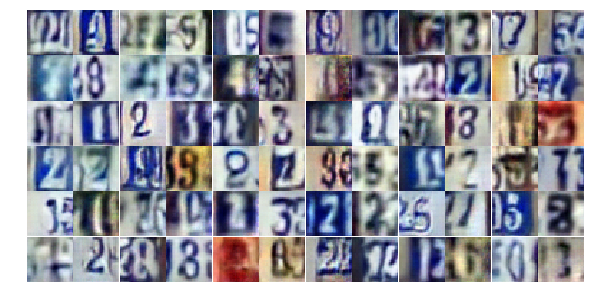

Epoch 19/25... Discriminator Loss: 0.6278... Generator Loss: 1.0093
Epoch 19/25... Discriminator Loss: 0.7685... Generator Loss: 0.8201
Epoch 19/25... Discriminator Loss: 0.6352... Generator Loss: 1.6543
Epoch 19/25... Discriminator Loss: 1.5485... Generator Loss: 0.3349
Epoch 19/25... Discriminator Loss: 0.9208... Generator Loss: 0.7434
Epoch 19/25... Discriminator Loss: 0.7002... Generator Loss: 1.3028
Epoch 19/25... Discriminator Loss: 2.6689... Generator Loss: 4.4354
Epoch 19/25... Discriminator Loss: 1.7589... Generator Loss: 0.3059
Epoch 19/25... Discriminator Loss: 1.4554... Generator Loss: 0.4857
Epoch 19/25... Discriminator Loss: 0.9501... Generator Loss: 0.7921


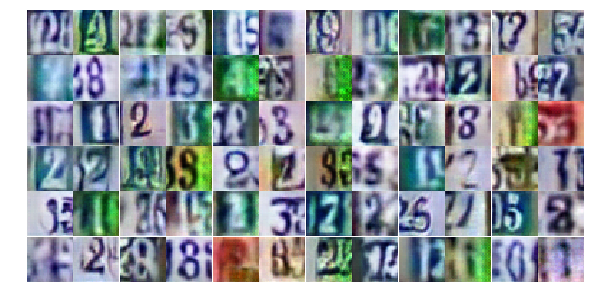

Epoch 19/25... Discriminator Loss: 0.7968... Generator Loss: 0.8872
Epoch 19/25... Discriminator Loss: 1.0980... Generator Loss: 0.6898
Epoch 19/25... Discriminator Loss: 1.0322... Generator Loss: 0.7104
Epoch 19/25... Discriminator Loss: 0.7356... Generator Loss: 1.0137
Epoch 19/25... Discriminator Loss: 1.3295... Generator Loss: 0.4915
Epoch 19/25... Discriminator Loss: 1.0637... Generator Loss: 0.6467
Epoch 19/25... Discriminator Loss: 0.7143... Generator Loss: 0.9522
Epoch 19/25... Discriminator Loss: 0.6249... Generator Loss: 1.1080
Epoch 19/25... Discriminator Loss: 0.6959... Generator Loss: 0.9628
Epoch 19/25... Discriminator Loss: 1.4961... Generator Loss: 0.3674


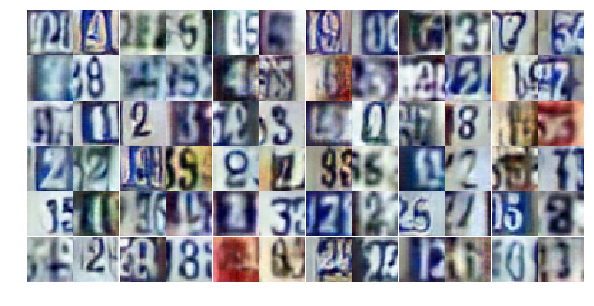

Epoch 19/25... Discriminator Loss: 1.0610... Generator Loss: 0.6534
Epoch 19/25... Discriminator Loss: 0.7225... Generator Loss: 0.8938
Epoch 19/25... Discriminator Loss: 0.9500... Generator Loss: 0.6809
Epoch 19/25... Discriminator Loss: 0.7183... Generator Loss: 0.9311
Epoch 19/25... Discriminator Loss: 0.5624... Generator Loss: 1.4906
Epoch 19/25... Discriminator Loss: 1.1449... Generator Loss: 0.6276
Epoch 19/25... Discriminator Loss: 0.6830... Generator Loss: 1.3172
Epoch 19/25... Discriminator Loss: 0.4512... Generator Loss: 1.6194
Epoch 19/25... Discriminator Loss: 0.8471... Generator Loss: 0.8166
Epoch 19/25... Discriminator Loss: 0.6325... Generator Loss: 1.0166


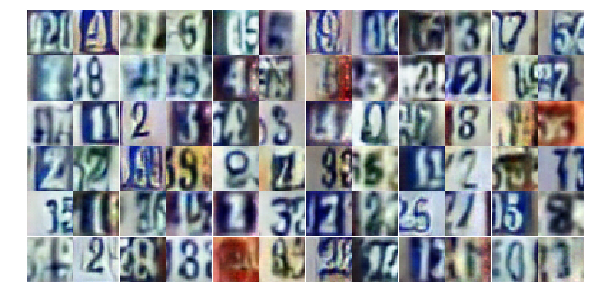

Epoch 19/25... Discriminator Loss: 0.5916... Generator Loss: 1.1258
Epoch 19/25... Discriminator Loss: 0.7553... Generator Loss: 0.9371
Epoch 19/25... Discriminator Loss: 1.1905... Generator Loss: 0.5030
Epoch 19/25... Discriminator Loss: 0.7386... Generator Loss: 0.8924
Epoch 19/25... Discriminator Loss: 0.9702... Generator Loss: 0.7099
Epoch 19/25... Discriminator Loss: 1.2624... Generator Loss: 0.8954
Epoch 19/25... Discriminator Loss: 0.7089... Generator Loss: 1.1437
Epoch 19/25... Discriminator Loss: 0.4558... Generator Loss: 1.4788
Epoch 19/25... Discriminator Loss: 0.6712... Generator Loss: 1.1399
Epoch 19/25... Discriminator Loss: 1.0790... Generator Loss: 0.6411


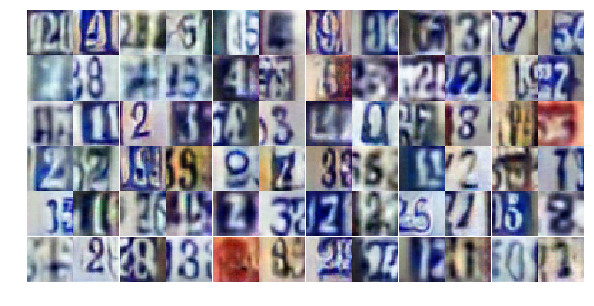

Epoch 19/25... Discriminator Loss: 0.7529... Generator Loss: 0.8835
Epoch 19/25... Discriminator Loss: 0.5827... Generator Loss: 1.6231
Epoch 19/25... Discriminator Loss: 0.6003... Generator Loss: 1.8070
Epoch 19/25... Discriminator Loss: 1.2618... Generator Loss: 0.4661
Epoch 19/25... Discriminator Loss: 0.5993... Generator Loss: 1.1623
Epoch 19/25... Discriminator Loss: 0.7196... Generator Loss: 0.9980
Epoch 19/25... Discriminator Loss: 1.5016... Generator Loss: 0.3742
Epoch 19/25... Discriminator Loss: 0.4995... Generator Loss: 1.2988
Epoch 20/25... Discriminator Loss: 1.5341... Generator Loss: 0.4127
Epoch 20/25... Discriminator Loss: 0.8167... Generator Loss: 0.8130


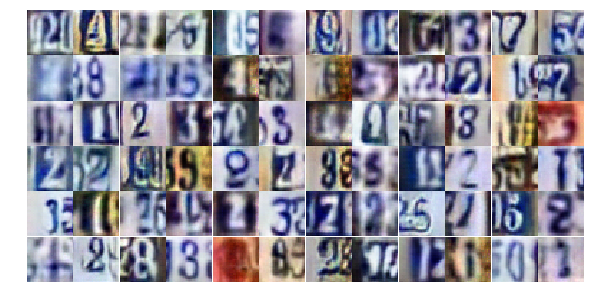

Epoch 20/25... Discriminator Loss: 0.7075... Generator Loss: 0.9663
Epoch 20/25... Discriminator Loss: 0.8433... Generator Loss: 0.8174
Epoch 20/25... Discriminator Loss: 1.3737... Generator Loss: 0.3964
Epoch 20/25... Discriminator Loss: 1.0536... Generator Loss: 0.6959
Epoch 20/25... Discriminator Loss: 0.6646... Generator Loss: 1.1801
Epoch 20/25... Discriminator Loss: 0.5828... Generator Loss: 1.6099
Epoch 20/25... Discriminator Loss: 0.6725... Generator Loss: 1.4101
Epoch 20/25... Discriminator Loss: 0.9557... Generator Loss: 0.7314
Epoch 20/25... Discriminator Loss: 0.7396... Generator Loss: 1.2449
Epoch 20/25... Discriminator Loss: 0.8233... Generator Loss: 0.7612


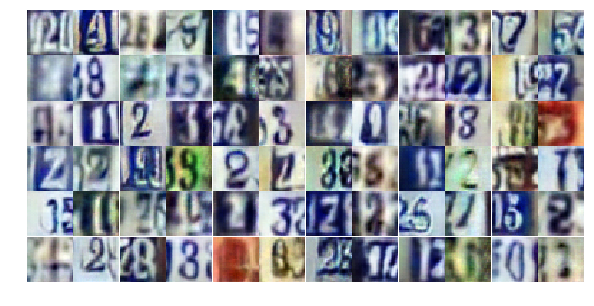

Epoch 20/25... Discriminator Loss: 1.7472... Generator Loss: 0.3013
Epoch 20/25... Discriminator Loss: 1.4061... Generator Loss: 0.4375
Epoch 20/25... Discriminator Loss: 1.0413... Generator Loss: 0.7101
Epoch 20/25... Discriminator Loss: 0.8272... Generator Loss: 0.9214
Epoch 20/25... Discriminator Loss: 1.1696... Generator Loss: 0.6040
Epoch 20/25... Discriminator Loss: 1.1644... Generator Loss: 0.5587
Epoch 20/25... Discriminator Loss: 1.2137... Generator Loss: 0.5630
Epoch 20/25... Discriminator Loss: 0.8920... Generator Loss: 0.8181
Epoch 20/25... Discriminator Loss: 0.5309... Generator Loss: 1.2197
Epoch 20/25... Discriminator Loss: 1.1205... Generator Loss: 0.6376


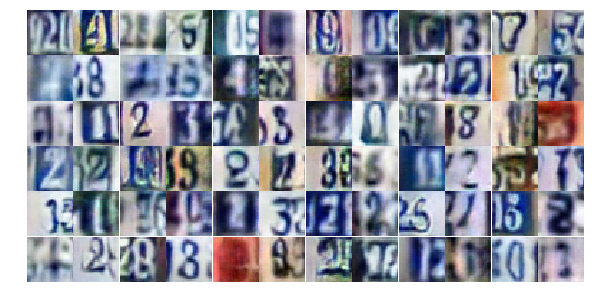

Epoch 20/25... Discriminator Loss: 0.7012... Generator Loss: 0.9650
Epoch 20/25... Discriminator Loss: 0.8119... Generator Loss: 0.8833
Epoch 20/25... Discriminator Loss: 0.2971... Generator Loss: 2.1128
Epoch 20/25... Discriminator Loss: 1.2915... Generator Loss: 0.5275
Epoch 20/25... Discriminator Loss: 0.9009... Generator Loss: 0.7342
Epoch 20/25... Discriminator Loss: 0.4459... Generator Loss: 1.3893
Epoch 20/25... Discriminator Loss: 0.5567... Generator Loss: 1.6771
Epoch 20/25... Discriminator Loss: 1.7236... Generator Loss: 0.3278
Epoch 20/25... Discriminator Loss: 1.0424... Generator Loss: 0.6248
Epoch 20/25... Discriminator Loss: 0.4393... Generator Loss: 1.3949


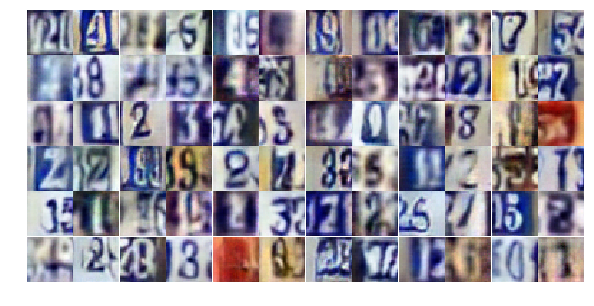

Epoch 20/25... Discriminator Loss: 0.6478... Generator Loss: 1.2519
Epoch 20/25... Discriminator Loss: 0.6275... Generator Loss: 1.0935
Epoch 20/25... Discriminator Loss: 1.3783... Generator Loss: 0.4656
Epoch 20/25... Discriminator Loss: 0.6190... Generator Loss: 2.0248
Epoch 20/25... Discriminator Loss: 1.2424... Generator Loss: 0.5857
Epoch 20/25... Discriminator Loss: 1.4628... Generator Loss: 0.4657
Epoch 20/25... Discriminator Loss: 1.8383... Generator Loss: 0.3475
Epoch 20/25... Discriminator Loss: 0.8741... Generator Loss: 1.1071
Epoch 20/25... Discriminator Loss: 0.7093... Generator Loss: 1.1070
Epoch 20/25... Discriminator Loss: 1.1345... Generator Loss: 0.5338


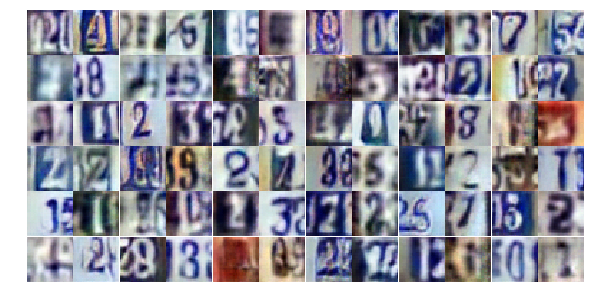

Epoch 20/25... Discriminator Loss: 1.0269... Generator Loss: 0.6661
Epoch 20/25... Discriminator Loss: 0.9803... Generator Loss: 0.6864
Epoch 20/25... Discriminator Loss: 0.8395... Generator Loss: 2.5782
Epoch 20/25... Discriminator Loss: 0.6423... Generator Loss: 1.0665
Epoch 20/25... Discriminator Loss: 1.0663... Generator Loss: 0.6671
Epoch 20/25... Discriminator Loss: 0.8716... Generator Loss: 0.7873
Epoch 20/25... Discriminator Loss: 1.0627... Generator Loss: 0.5931
Epoch 20/25... Discriminator Loss: 0.3739... Generator Loss: 1.7263
Epoch 20/25... Discriminator Loss: 0.6634... Generator Loss: 1.0412
Epoch 20/25... Discriminator Loss: 0.9016... Generator Loss: 0.7356


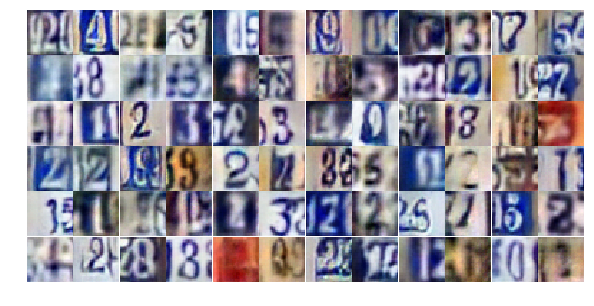

Epoch 20/25... Discriminator Loss: 0.4791... Generator Loss: 1.5700
Epoch 20/25... Discriminator Loss: 0.6648... Generator Loss: 1.3469
Epoch 20/25... Discriminator Loss: 0.4549... Generator Loss: 2.1111
Epoch 20/25... Discriminator Loss: 1.0212... Generator Loss: 1.9345
Epoch 20/25... Discriminator Loss: 0.4892... Generator Loss: 1.3692
Epoch 20/25... Discriminator Loss: 1.1590... Generator Loss: 0.5055
Epoch 21/25... Discriminator Loss: 1.2112... Generator Loss: 0.5583
Epoch 21/25... Discriminator Loss: 0.8483... Generator Loss: 0.7635
Epoch 21/25... Discriminator Loss: 1.1303... Generator Loss: 0.6213
Epoch 21/25... Discriminator Loss: 1.0996... Generator Loss: 0.6311


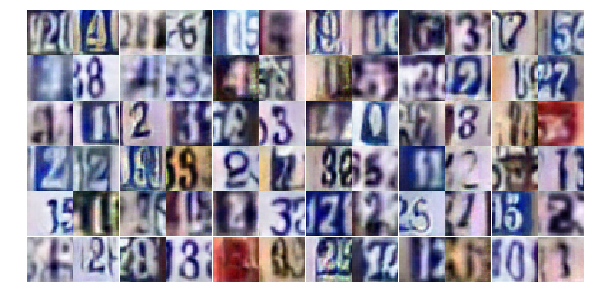

Epoch 21/25... Discriminator Loss: 0.6244... Generator Loss: 1.2404
Epoch 21/25... Discriminator Loss: 1.4210... Generator Loss: 0.4276
Epoch 21/25... Discriminator Loss: 0.7831... Generator Loss: 0.8620
Epoch 21/25... Discriminator Loss: 0.4118... Generator Loss: 1.5169
Epoch 21/25... Discriminator Loss: 0.7273... Generator Loss: 0.9951
Epoch 21/25... Discriminator Loss: 1.0526... Generator Loss: 0.7095
Epoch 21/25... Discriminator Loss: 1.1758... Generator Loss: 0.5830
Epoch 21/25... Discriminator Loss: 0.6764... Generator Loss: 1.1967
Epoch 21/25... Discriminator Loss: 0.7669... Generator Loss: 0.8857
Epoch 21/25... Discriminator Loss: 1.4248... Generator Loss: 0.3784


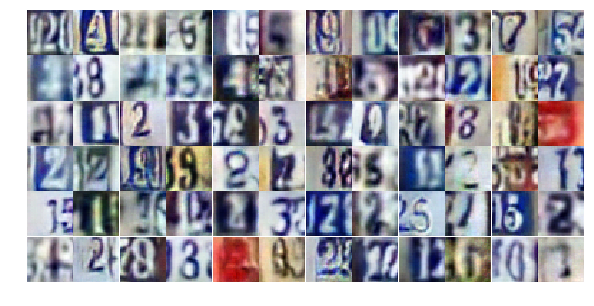

Epoch 21/25... Discriminator Loss: 0.3363... Generator Loss: 1.8336
Epoch 21/25... Discriminator Loss: 0.9777... Generator Loss: 0.7019
Epoch 21/25... Discriminator Loss: 0.8518... Generator Loss: 1.6820
Epoch 21/25... Discriminator Loss: 0.8132... Generator Loss: 0.9679
Epoch 21/25... Discriminator Loss: 0.7829... Generator Loss: 0.8783
Epoch 21/25... Discriminator Loss: 1.4659... Generator Loss: 0.3857
Epoch 21/25... Discriminator Loss: 0.7551... Generator Loss: 1.3547
Epoch 21/25... Discriminator Loss: 0.4070... Generator Loss: 1.7298
Epoch 21/25... Discriminator Loss: 0.6000... Generator Loss: 1.1540
Epoch 21/25... Discriminator Loss: 0.6097... Generator Loss: 1.2981


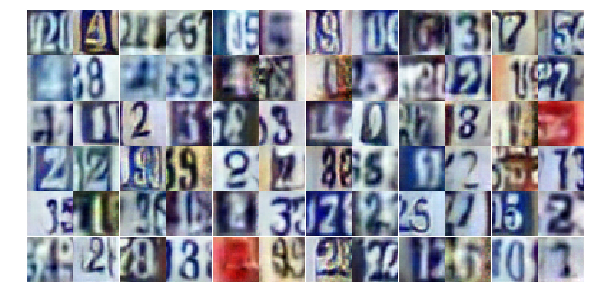

Epoch 21/25... Discriminator Loss: 1.5012... Generator Loss: 0.3694
Epoch 21/25... Discriminator Loss: 0.3853... Generator Loss: 1.7369
Epoch 21/25... Discriminator Loss: 0.8768... Generator Loss: 0.8306
Epoch 21/25... Discriminator Loss: 0.6448... Generator Loss: 1.1133
Epoch 21/25... Discriminator Loss: 0.8537... Generator Loss: 0.8572
Epoch 21/25... Discriminator Loss: 1.2671... Generator Loss: 0.4877
Epoch 21/25... Discriminator Loss: 0.7753... Generator Loss: 0.8956
Epoch 21/25... Discriminator Loss: 1.0096... Generator Loss: 0.6961
Epoch 21/25... Discriminator Loss: 1.4839... Generator Loss: 0.3539
Epoch 21/25... Discriminator Loss: 2.2165... Generator Loss: 0.2425


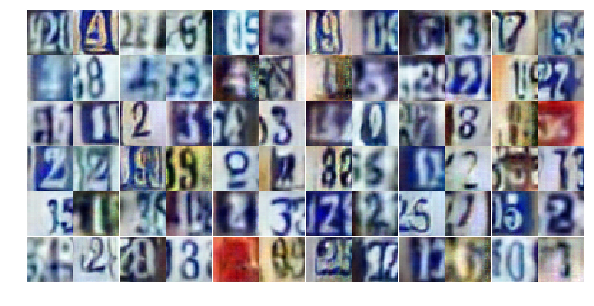

Epoch 21/25... Discriminator Loss: 0.9066... Generator Loss: 0.6973
Epoch 21/25... Discriminator Loss: 0.6999... Generator Loss: 0.9765
Epoch 21/25... Discriminator Loss: 1.2418... Generator Loss: 0.5382
Epoch 21/25... Discriminator Loss: 0.4776... Generator Loss: 1.4312
Epoch 21/25... Discriminator Loss: 0.5572... Generator Loss: 1.1387
Epoch 21/25... Discriminator Loss: 0.7573... Generator Loss: 0.9909
Epoch 21/25... Discriminator Loss: 0.7666... Generator Loss: 1.0259
Epoch 21/25... Discriminator Loss: 1.5993... Generator Loss: 0.3869
Epoch 21/25... Discriminator Loss: 0.6427... Generator Loss: 1.4170
Epoch 21/25... Discriminator Loss: 5.3005... Generator Loss: 0.0417


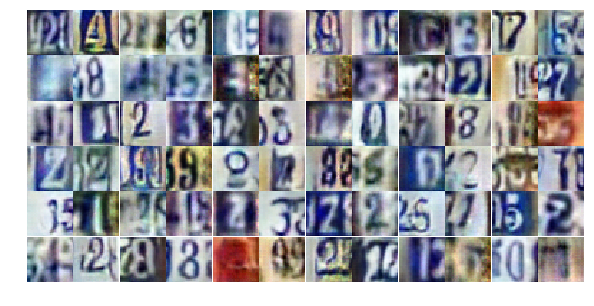

Epoch 21/25... Discriminator Loss: 1.3028... Generator Loss: 1.5872
Epoch 21/25... Discriminator Loss: 1.7371... Generator Loss: 0.3189
Epoch 21/25... Discriminator Loss: 0.7373... Generator Loss: 1.0428
Epoch 21/25... Discriminator Loss: 0.8634... Generator Loss: 0.8718
Epoch 21/25... Discriminator Loss: 0.4197... Generator Loss: 1.7729
Epoch 21/25... Discriminator Loss: 0.8869... Generator Loss: 0.8044
Epoch 21/25... Discriminator Loss: 0.9099... Generator Loss: 0.6853
Epoch 21/25... Discriminator Loss: 0.7759... Generator Loss: 0.9619
Epoch 21/25... Discriminator Loss: 0.9805... Generator Loss: 0.6701
Epoch 21/25... Discriminator Loss: 0.4962... Generator Loss: 1.4470


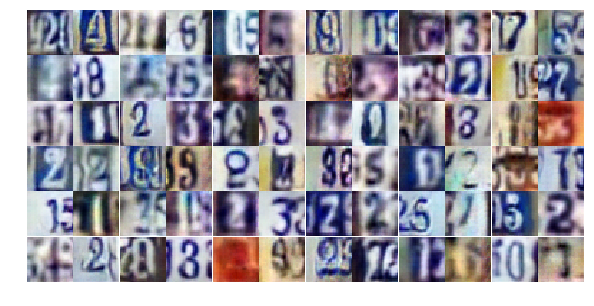

Epoch 21/25... Discriminator Loss: 0.6521... Generator Loss: 1.3428
Epoch 21/25... Discriminator Loss: 1.0384... Generator Loss: 0.6319
Epoch 21/25... Discriminator Loss: 0.7997... Generator Loss: 1.4806
Epoch 22/25... Discriminator Loss: 0.7005... Generator Loss: 1.5225
Epoch 22/25... Discriminator Loss: 1.0905... Generator Loss: 0.6027
Epoch 22/25... Discriminator Loss: 0.7256... Generator Loss: 1.2156
Epoch 22/25... Discriminator Loss: 0.6168... Generator Loss: 1.1244
Epoch 22/25... Discriminator Loss: 0.5434... Generator Loss: 1.2849
Epoch 22/25... Discriminator Loss: 0.9718... Generator Loss: 0.6923
Epoch 22/25... Discriminator Loss: 1.0820... Generator Loss: 0.5485


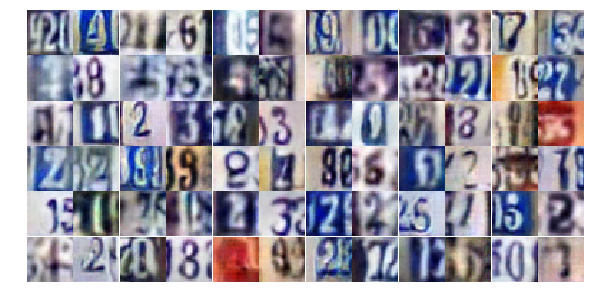

Epoch 22/25... Discriminator Loss: 0.5111... Generator Loss: 1.8354
Epoch 22/25... Discriminator Loss: 0.8153... Generator Loss: 0.9032
Epoch 22/25... Discriminator Loss: 1.4522... Generator Loss: 0.3734
Epoch 22/25... Discriminator Loss: 0.9000... Generator Loss: 0.7710
Epoch 22/25... Discriminator Loss: 0.8167... Generator Loss: 0.8668
Epoch 22/25... Discriminator Loss: 0.8113... Generator Loss: 0.8606
Epoch 22/25... Discriminator Loss: 0.6734... Generator Loss: 1.0783
Epoch 22/25... Discriminator Loss: 0.5789... Generator Loss: 1.3823
Epoch 22/25... Discriminator Loss: 0.9966... Generator Loss: 0.6774
Epoch 22/25... Discriminator Loss: 1.6767... Generator Loss: 0.2978


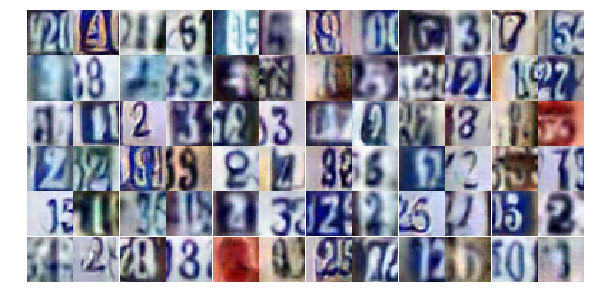

Epoch 22/25... Discriminator Loss: 0.3834... Generator Loss: 1.8088
Epoch 22/25... Discriminator Loss: 0.5811... Generator Loss: 1.0871
Epoch 22/25... Discriminator Loss: 0.9769... Generator Loss: 0.6938
Epoch 22/25... Discriminator Loss: 0.4313... Generator Loss: 1.4670
Epoch 22/25... Discriminator Loss: 0.3878... Generator Loss: 1.6044
Epoch 22/25... Discriminator Loss: 0.9267... Generator Loss: 0.7340
Epoch 22/25... Discriminator Loss: 0.3584... Generator Loss: 1.9577
Epoch 22/25... Discriminator Loss: 0.3352... Generator Loss: 2.1719
Epoch 22/25... Discriminator Loss: 0.5654... Generator Loss: 1.1721
Epoch 22/25... Discriminator Loss: 0.7294... Generator Loss: 0.8964


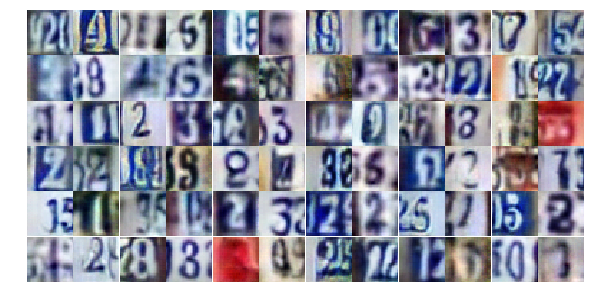

Epoch 22/25... Discriminator Loss: 0.3321... Generator Loss: 1.7241
Epoch 22/25... Discriminator Loss: 0.7268... Generator Loss: 0.9409
Epoch 22/25... Discriminator Loss: 1.0216... Generator Loss: 0.6670
Epoch 22/25... Discriminator Loss: 0.8165... Generator Loss: 0.9410
Epoch 22/25... Discriminator Loss: 0.9874... Generator Loss: 0.7470
Epoch 22/25... Discriminator Loss: 1.0933... Generator Loss: 0.5362
Epoch 22/25... Discriminator Loss: 1.4779... Generator Loss: 0.4153
Epoch 22/25... Discriminator Loss: 0.6502... Generator Loss: 1.3716
Epoch 22/25... Discriminator Loss: 0.8435... Generator Loss: 1.0967
Epoch 22/25... Discriminator Loss: 0.8247... Generator Loss: 0.8430


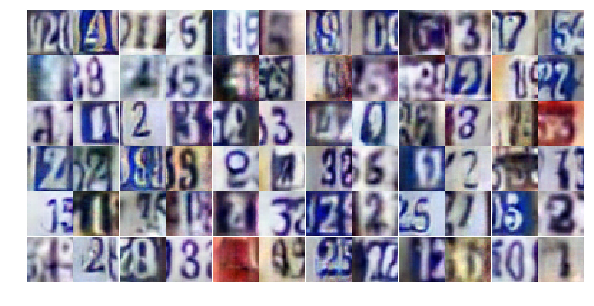

Epoch 22/25... Discriminator Loss: 0.9471... Generator Loss: 0.7110
Epoch 22/25... Discriminator Loss: 0.5109... Generator Loss: 1.2691
Epoch 22/25... Discriminator Loss: 0.5480... Generator Loss: 1.1732
Epoch 22/25... Discriminator Loss: 0.5607... Generator Loss: 1.2763


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))